### 2016 Boston Marathon - EDA 
#### Catch me if you can - the effect of elevation and runners split's strategy on their performance at the 2016 Boston marathon

In [1]:
import numpy as np
import scipy.stats as stats
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
sns.set_style('whitegrid')

%matplotlib inline
%config InlineBackend.figure_format ='retina'

- Can the finish times be predicted? What are the primary factors?

- Can the results from 2015 tell you anything about the 2016 race (e.g. can you predict winners/times, do certain athletes improve, etc.)?
- When/where do athletes slow down? Can you identify when an athlete “hits the wall”? How does the elevation play a role in the athlete’s pacing?
- Can you visualize the race?
- How do men’s and women’s results differ?
- What’s the most dominant country? City?

In [2]:
boston_2016 = pd.read_csv('../raw_data/marathon_results_2016.csv')

In [3]:
'''Separating Last Name from First and Middle names and then dropping Name col'''

boston_2016['last_name'], boston_2016['first_names'] = boston_2016['Name'].str.split(',', 1).str
# boston_2016.drop('Name', axis=1, inplace=True)

'''Dropping Unnamed var, do not know what this var is, revise if time'''
boston_2016.drop('Unnamed: 8', axis=1, inplace=True)

In [4]:
boston_2016[['last_name','first_names', 'Name' ]].head(10)

,last_name,first_names,Name
0,Hayle,Lemi Berhanu,"Hayle, Lemi Berhanu"
1,Desisa,Lelisa,"Desisa, Lelisa"
2,Tsegay,Yemane Adhane,"Tsegay, Yemane Adhane"
3,Korir,Wesley,"Korir, Wesley"
4,Lonyangata,Paul,"Lonyangata, Paul"
5,Kitwara,Sammy,"Kitwara, Sammy"
6,Chebogut,Stephen,"Chebogut, Stephen"
7,Nageeye,Abdi,"Nageeye, Abdi"
8,Feleke,Getu,"Feleke, Getu"
9,Hine,Zachary,"Hine, Zachary"


In [5]:
'''Renaming variables in a way that it is consistent with 2015 data'''
old_names_16 = boston_2016.columns.tolist()
new_names_16 = ['bib_number', 'name_16', 'age', 'gender', 'city', 'state', 'country_res', 'country_ctz', '5_k', '10_k', '15_k',
                '20_k','half','25_k', '30_k','35_k','40_k', 'pace','proj_time', 'official_time',
                'rank_overall', 'rank_over_gender', 'rank_over_division','last_name','first_names']

boston_2016.rename(columns=dict(zip(old_names_16, new_names_16)), inplace=True)

In [6]:
print boston_2016.shape
print ''
boston_2016.head(3).T

(26630, 25)



,0,1,2
bib_number,5,1,6
name_16,"Hayle, Lemi Berhanu","Desisa, Lelisa","Tsegay, Yemane Adhane"
age,21,26,31
gender,M,M,M
city,Addis Ababa,Ambo,Addis Ababa
state,NaN,NaN,NaN
country_res,ETH,ETH,ETH
country_ctz,NaN,NaN,NaN
5_k,0:15:47,0:15:47,0:15:46
10_k,0:31:20,0:31:21,0:31:20


In [7]:
boston_2016.describe().T

,count,mean,std,min,25%,50%,75%,max
age,26630.0,42.514044,11.347955,18.0,34.00,43.0,51.00,83.0
rank_overall,26630.0,13314.764176,7687.226481,1.0,6658.25,13314.5,19971.75,26629.0
rank_over_gender,26630.0,6707.085242,3928.246611,1.0,3329.00,6657.5,9986.00,14463.0
rank_over_division,26630.0,1613.305896,1443.420260,1.0,510.00,1180.0,2198.00,5946.0


In [8]:
boston_2016.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 26630 entries, 0 to 26629
Data columns (total 25 columns):
bib_number            26630 non-null object
name_16               26630 non-null object
age                   26630 non-null int64
gender                26630 non-null object
city                  26629 non-null object
state                 23783 non-null object
country_res           26630 non-null object
country_ctz           1122 non-null object
5_k                   26630 non-null object
10_k                  26630 non-null object
15_k                  26630 non-null object
20_k                  26630 non-null object
half                  26630 non-null object
25_k                  26630 non-null object
30_k                  26630 non-null object
35_k                  26630 non-null object
40_k                  26630 non-null object
pace                  26630 non-null object
proj_time             26630 non-null object
official_time         26630 non-null object
rank_overall 

In [9]:
'''City has numerical entries and entries that includes country names'''
boston_2016['new_city'], boston_2016['country_mistake'] = boston_2016['city'].str.split(',', 1).str

'''In the new city column there are numbers, need to remove'''
boston_2016['new_city'] = boston_2016['new_city'].astype(str).map(lambda x: x.lstrip('08512083234-120570095630'))
boston_2016['new_city'] = boston_2016['new_city'].map(lambda x:x.lstrip())
boston_2016['new_city'] = boston_2016['new_city'].str.lower()

'''Dropping col'''
boston_2016.drop(['country_mistake', 'city'], axis=1, inplace=True)

'''renaming new city'''
boston_2016.rename(columns={'new_city': 'city'}, inplace=True)

'''replacing missing/nonentry with nan in city'''
boston_2016['city'] = boston_2016['city'].replace('', 'nan')

### Checking duplicates and missing values
---

In [10]:
'''Duplicates func'''
def duplic_checker(data, col_list):
    for col in col_list:
        if data[col].duplicated().any() == True:
            print "There are duplicates in " + col
            print('-' * 20 + '\n')
        elif data[col].duplicated().any() == False:
            pass
            #print "No duplicates in ", col
            
'''Missing func'''   
def missing_checker(data, col_list):
    for col in col_list:
        if data[col].isnull().sum() > 0:
            sum_misv = data[col].isnull().sum()
            print "Nimber of missing values in " + col + " is:", sum_misv
            print('-' * 20 + '\n')
        elif data[col].isnull().sum() == 0:
            pass

In [11]:
'''duplicates'''
cols_ = boston_2016.columns.tolist()
duplic_checker(boston_2016, cols_ )

There are duplicates in name_16
--------------------

There are duplicates in age
--------------------

There are duplicates in gender
--------------------

There are duplicates in state
--------------------

There are duplicates in country_res
--------------------

There are duplicates in country_ctz
--------------------

There are duplicates in 5_k
--------------------

There are duplicates in 10_k
--------------------

There are duplicates in 15_k
--------------------

There are duplicates in 20_k
--------------------

There are duplicates in half
--------------------

There are duplicates in 25_k
--------------------

There are duplicates in 30_k
--------------------

There are duplicates in 35_k
--------------------

There are duplicates in 40_k
--------------------

There are duplicates in pace
--------------------

There are duplicates in proj_time
--------------------

There are duplicates in official_time
--------------------

There are duplicates in rank_overall
-------------

In [12]:
'''missing values'''
missing_checker(boston_2016,cols_ )

Nimber of missing values in state is: 2847
--------------------

Nimber of missing values in country_ctz is: 25508
--------------------



In [13]:
des= '''No duplicates based on bib number, we can assume that the total number of runners in 2016 were: '''
print des, boston_2016.shape[0]
print ''
des_1 = '''Total number of male runners in the 2016 boston marathon was: '''
print des_1, boston_2016.gender.value_counts().values[0]
print ''
des_1 = '''Total number of female runners in the 2015 boston marathon was: '''
print des_1, boston_2016.gender.value_counts().values[1]

No duplicates based on bib number, we can assume that the total number of runners in 2016 were:  26630

Total number of male runners in the 2016 boston marathon was:  14463

Total number of female runners in the 2015 boston marathon was:  12167


### Closer look at Age
---

In [14]:
font = {'family': 'serif',
        'color':  'black',
        'weight': 'normal',
        'size': 16,
        }
''''''

# darkred
def histogram_plotter(title, data):
    sns.set(rc={"figure.figsize": (10, 7)})
    sns.set_style('white')
#     dist = sns.distplot(data, kde=False, bins=30)
    dist = sns.distplot(data, hist_kws={'alpha':0.2}, kde_kws={'linewidth':5})
    
    dist.axvline(np.mean(data), lw=5, c='darkred', ls='dashed')
    average_roll = '{0:.2f}'.format(np.mean(data))
    title = 'Distribution of ' + title + ' average = '  + average_roll + '\n'
    dist.set_title(title, fontdict=font)
    dist.set_xlabel(data, fontdict=font)
    dist = sns.distplot(data, hist_kws={'alpha':0.2}, kde_kws={'linewidth':5})

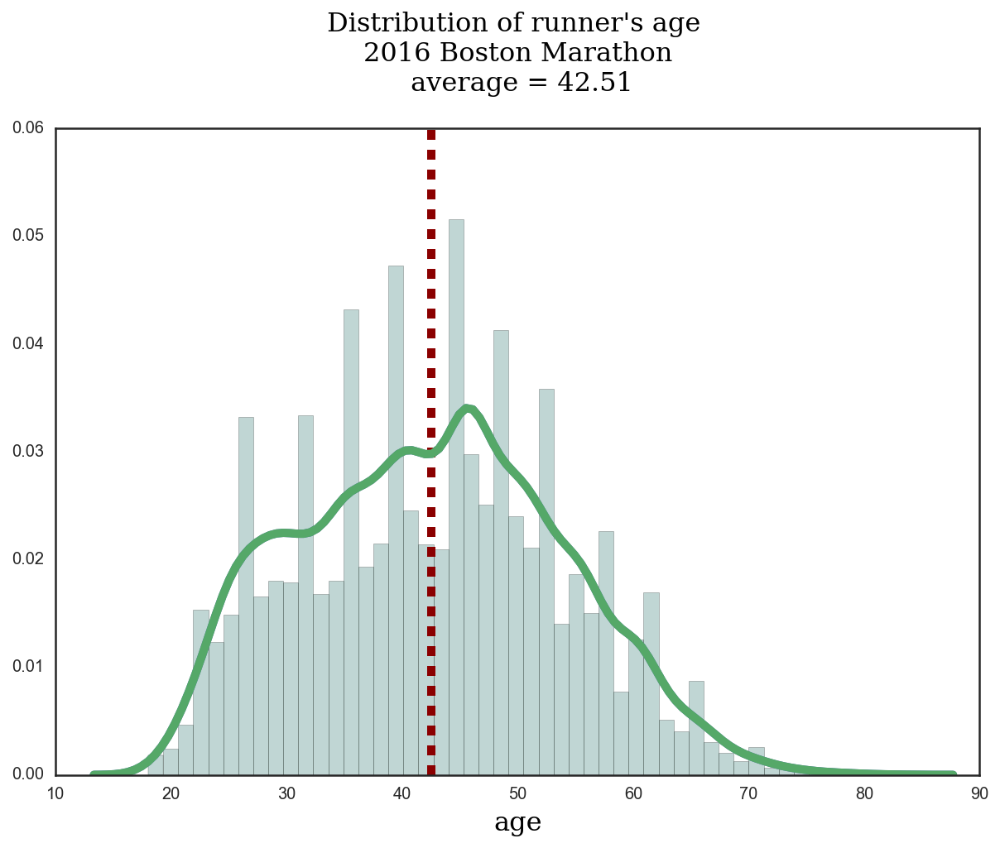

In [15]:
histogram_plotter("runner's age \n2016 Boston Marathon\n", boston_2016.age)

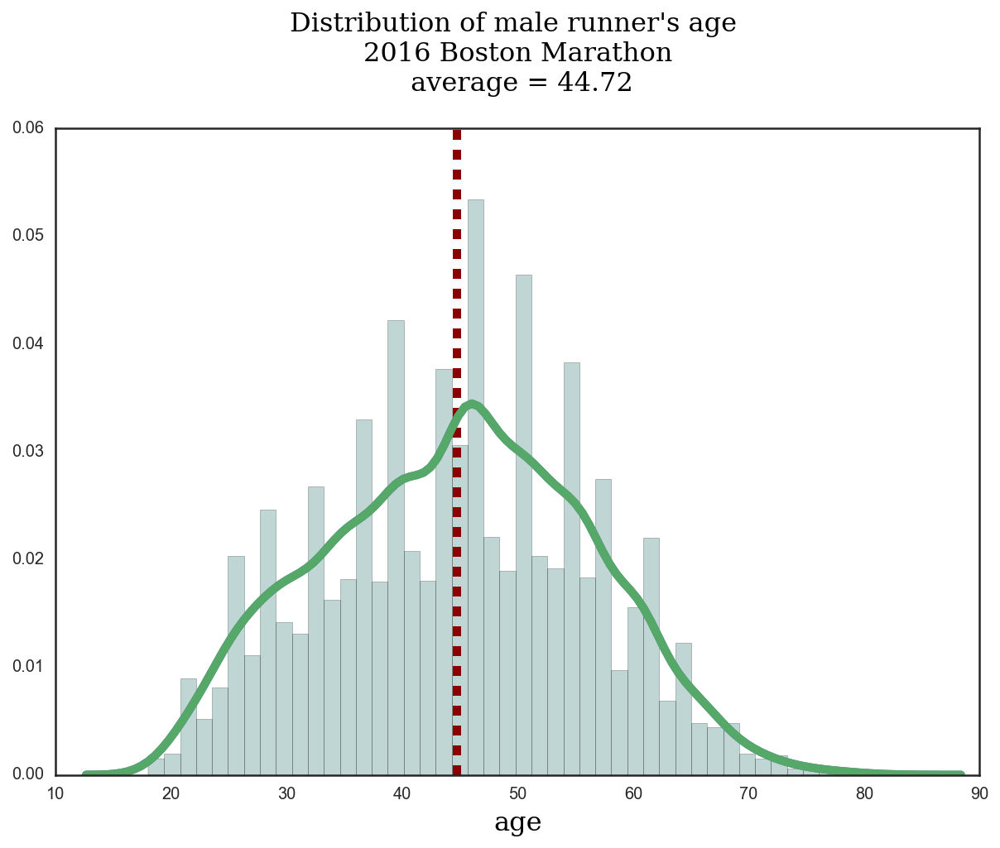

In [16]:
histogram_plotter("male runner's age \n2016 Boston Marathon\n", boston_2016[boston_2016.gender=='M'].age)

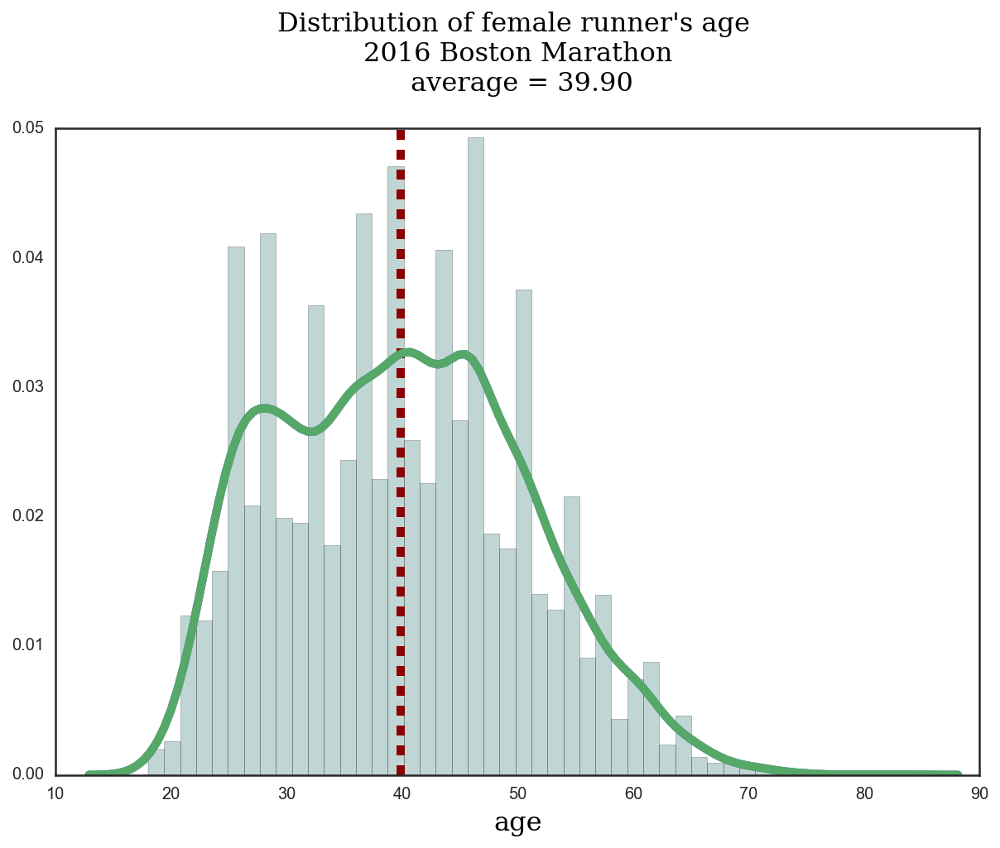

In [17]:
histogram_plotter("female runner's age \n2016 Boston Marathon\n", boston_2016[boston_2016.gender=='F'].age)

### Closer look at Country of Residence and Citizenship
---

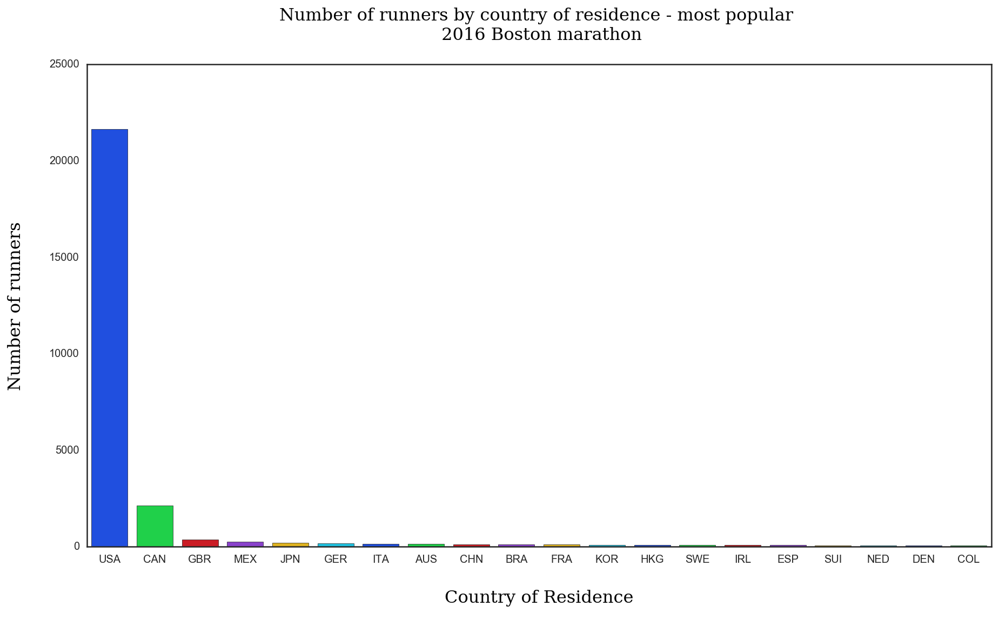

In [18]:
'''Most Popular countries of residence'''
fig = plt.figure(figsize=(15,8))
ax = fig.gca()

pop_co = boston_2016.groupby('country_res')['bib_number'].count().sort_values(ascending=False).head(20)
ax = sns.barplot(pop_co.index, pop_co, ax=ax, palette='bright')

plt.title('Number of runners by country of residence - most popular \n 2016 Boston marathon\n', fontdict=font)

plt.ylabel('Number of runners\n', fontdict=font)
plt.xlabel('\nCountry of Residence\n', fontdict=font)
plt.show()

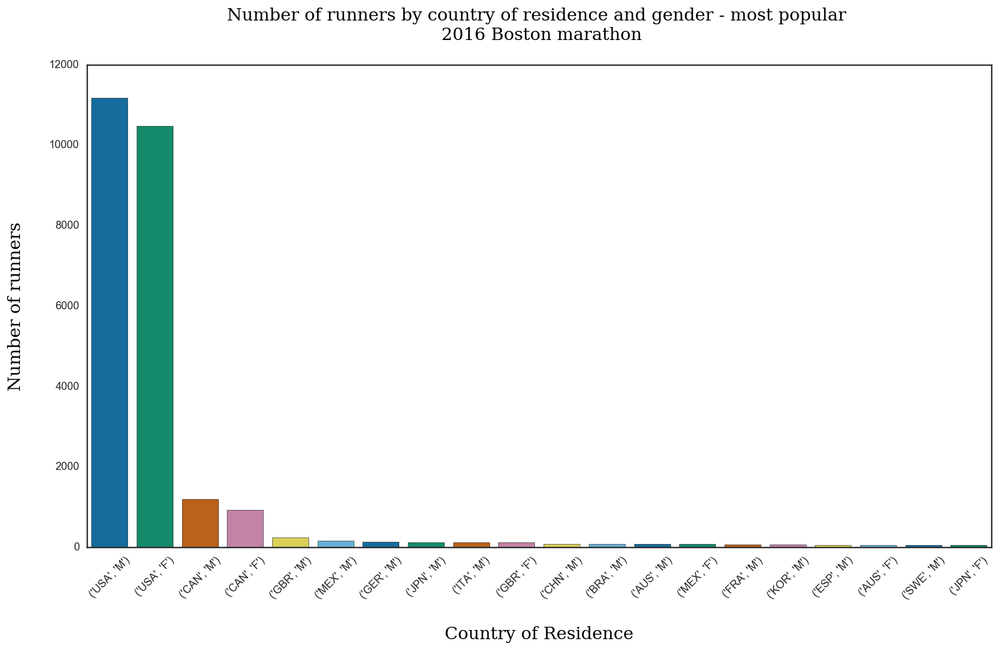

In [19]:
'''Number of runners by gender and country of residence'''
fig = plt.figure(figsize=(15,8))
ax = fig.gca()


pop_co2 = boston_2016.groupby(['country_res', 'gender'])['bib_number'].count().sort_values(ascending=False).head(20)
ax = sns.barplot(pop_co2.index, pop_co2, ax=ax, palette='colorblind')

plt.title('Number of runners by country of residence and gender - most popular \n 2016 Boston marathon\n', 
          fontdict=font)

plt.ylabel('Number of runners\n', fontdict=font)
plt.xlabel('\nCountry of Residence\n', fontdict=font)
ax.set_xticklabels(pop_co2.index, rotation=45)
plt.show()

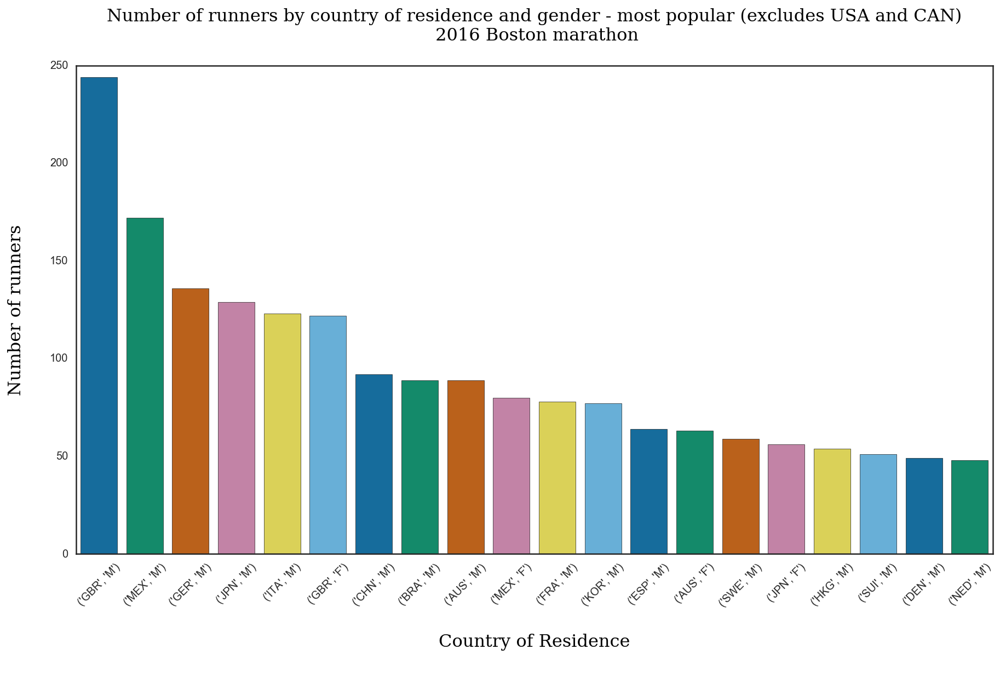

In [20]:
'''It looks like USA and Canada have a lot of participants => removing them'''
fig = plt.figure(figsize=(15,8))
ax = fig.gca()

pop_co2 = boston_2016[ (boston_2016['country_res']!="USA" ) & (boston_2016['country_res']!="CAN" )].groupby(['country_res', 'gender'])['bib_number'].count().sort_values(ascending=False).head(20)
ax = sns.barplot(pop_co2.index, pop_co2, ax=ax, palette='colorblind')

plt.title('Number of runners by country of residence and gender - most popular (excludes USA and CAN)\n 2016 Boston marathon\n'
          , fontdict=font)


plt.ylabel('Number of runners\n', fontdict=font)
plt.xlabel('\nCountry of Residence\n', fontdict=font)
ax.set_xticklabels(pop_co2.index, rotation=45)
plt.show()

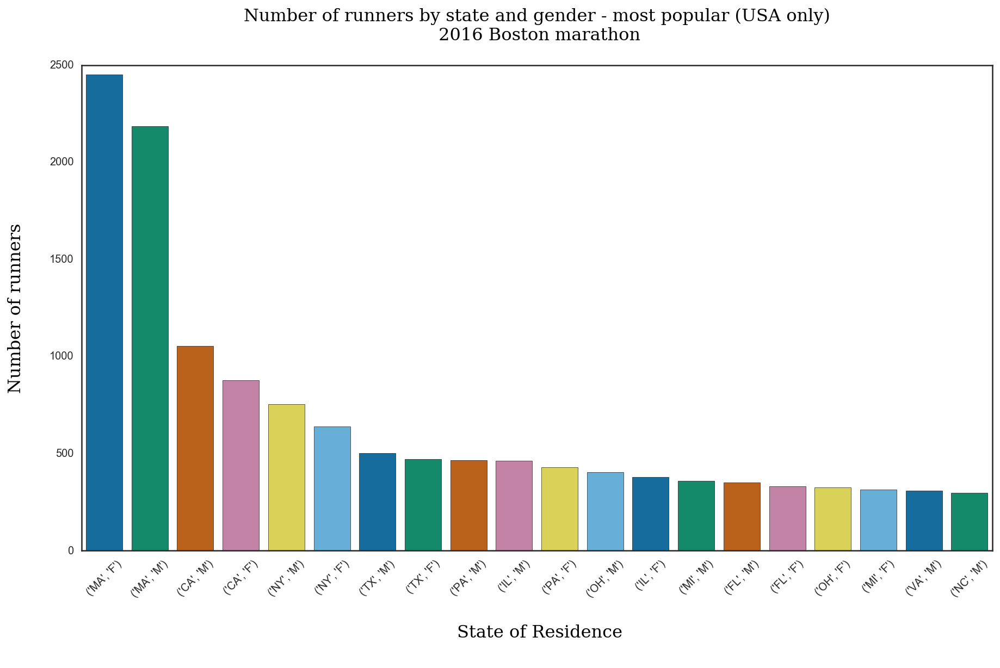

In [21]:
'''Most popular participants by State in the USA'''
fig = plt.figure(figsize=(15,8))
ax = fig.gca()

pop_co2 = boston_2016[ (boston_2016['country_res']=='USA') & (boston_2016['state']!="NaN")].groupby(['state', 'gender'])['bib_number'].count().sort_values(ascending=False).head(20)
ax = sns.barplot(pop_co2.index, pop_co2, ax=ax, palette='colorblind')

plt.title('Number of runners by state and gender - most popular (USA only)\n 2016 Boston marathon\n', 
          fontdict=font)
plt.ylabel('Number of runners\n', fontdict=font)
plt.xlabel('\n State of Residence\n', fontdict=font)
ax.set_xticklabels(pop_co2.index, rotation=45)
plt.show()

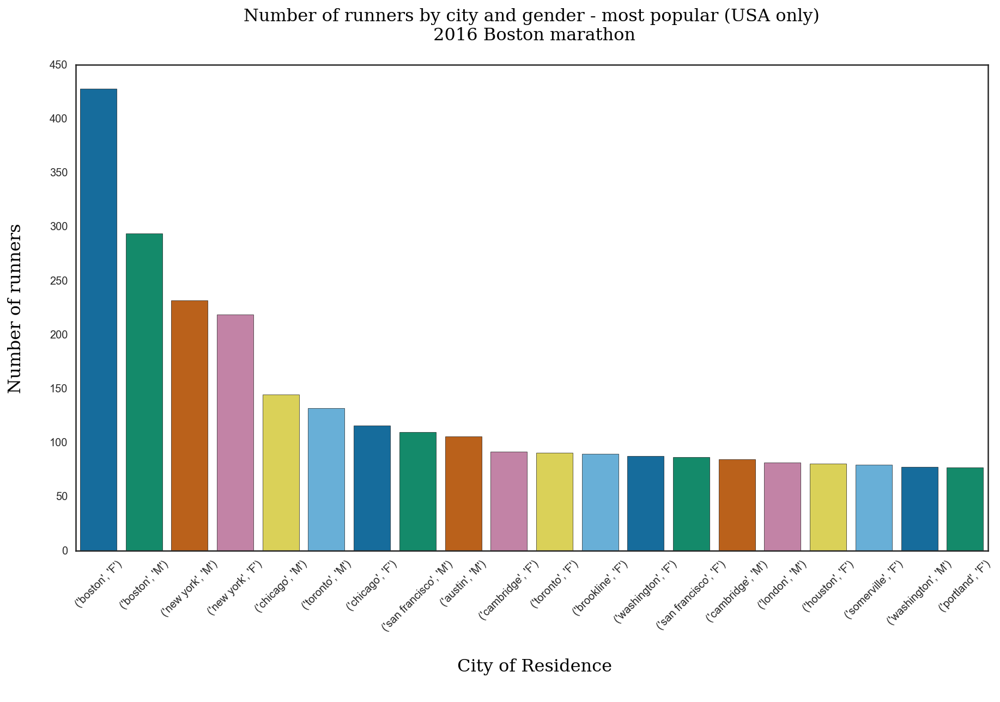

In [22]:
'''Most popular participants by City '''
fig = plt.figure(figsize=(15,8))
ax = fig.gca()

pop_co2 = boston_2016[(boston_2016['city'] != 'nan')].groupby(['city', 'gender'])['bib_number'].count().sort_values(ascending=False).head(20)
ax = sns.barplot(pop_co2.index, pop_co2, ax=ax, palette='colorblind')

plt.title('Number of runners by city and gender - most popular (USA only)\n 2016 Boston marathon\n', 
          fontdict=font)
plt.ylabel('Number of runners\n', fontdict=font)
plt.xlabel('\n City of Residence\n', fontdict=font)
ax.set_xticklabels(pop_co2.index, rotation=45)
plt.show()

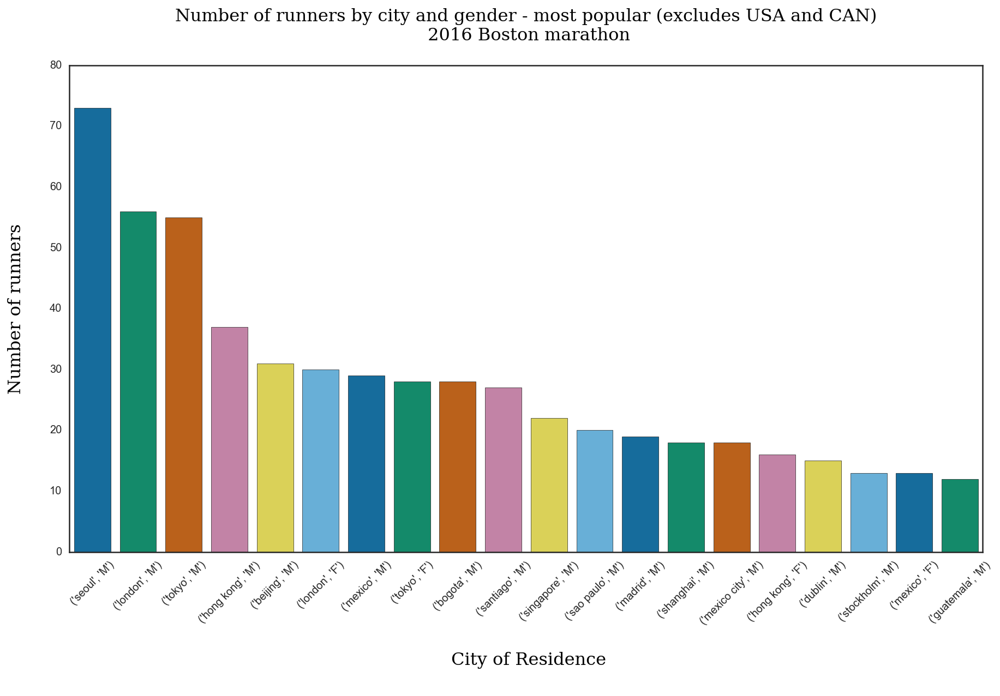

In [23]:
'''Most popular participants by City exluding USA and CAN '''
fig = plt.figure(figsize=(15,8))
ax = fig.gca()

pop_co2 = boston_2016[ (boston_2016['city'] != 'nan') & (boston_2016['country_res']!="USA" ) 
                      & (boston_2016['country_res']!="CAN" )].groupby(['city', 'gender'])['bib_number'].count().sort_values(ascending=False).head(20)
ax = sns.barplot(pop_co2.index, pop_co2, ax=ax, palette='colorblind')

plt.title('Number of runners by city and gender - most popular (excludes USA and CAN)\n 2016 Boston marathon\n', 
          fontdict=font)
plt.ylabel('Number of runners\n', fontdict=font)
plt.xlabel('\n City of Residence\n', fontdict=font)
ax.set_xticklabels(pop_co2.index, rotation=45)
plt.show()

### Time analysis

In [24]:
'''Function to change time to minutes'''
def minute_time(data):
    if data is not '-':
        data = data.replace('-', '0:0:0')
        data = data.str.split(':').apply(lambda x: int(x[0]) * 60.0 
                                         + int(x[1]) + np.true_divide(int(x[2]),60))
        return data
    else:
        return -1

In [25]:
col_list = ['5_k', '10_k', '15_k', '20_k', 'half', '25_k', '30_k', '35_k', '40_k', 'pace', 'proj_time',
            'official_time',]
for col in col_list:
    boston_2016[col] = minute_time(boston_2016[col])

In [26]:
## boston_2016['5_k_copy'] = boston_2016['5_k_copy'].replace('-', '0:0:0')
## boston_2016['5_k_copy'] = boston_2016['5_k_copy'].str.split(':').apply(lambda x: int(x[0]) * 60.0 + int(x[1]) + 
##                                                                       np.true_divide(int(x[2]),60))

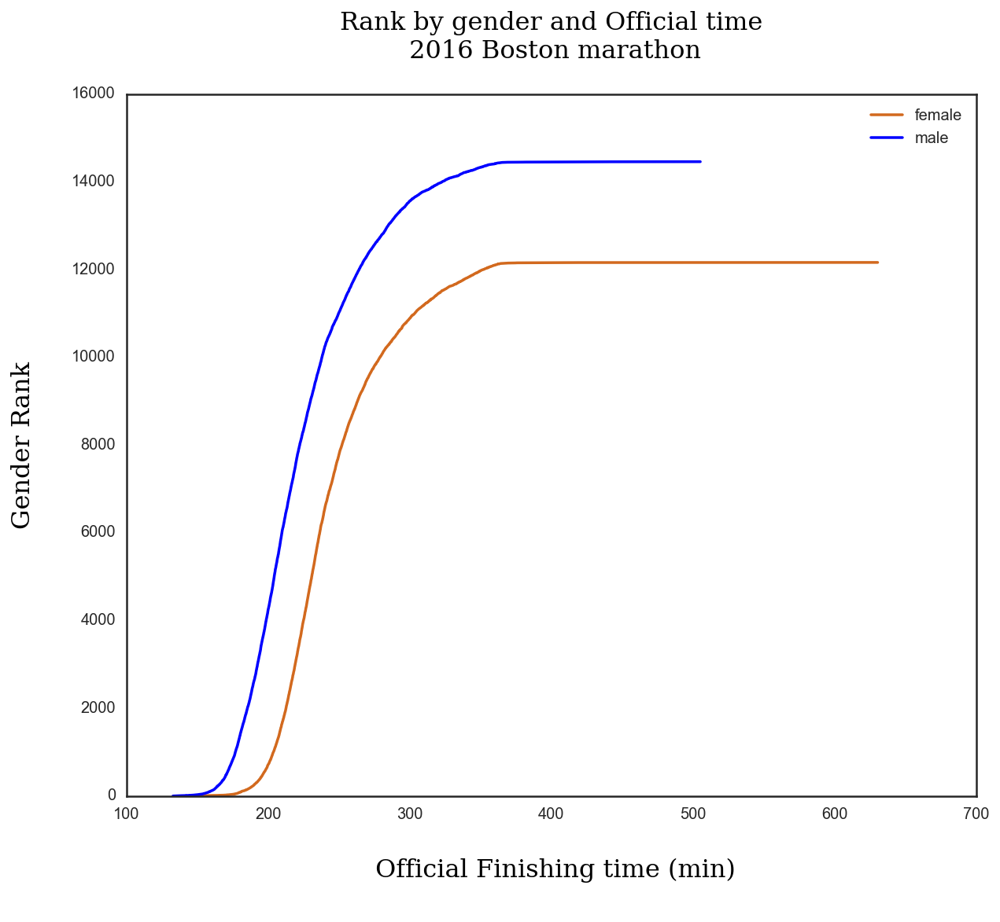

In [28]:
bost_fem = boston_2016['gender'] == 'F'
bost_mal = boston_2016['gender'] == 'M'
fig = plt.figure(figsize=(10,8))
ax = fig.gca()
''''''
sns.set_style("whitegrid")
plt.plot(boston_2016[bost_fem].official_time, boston_2016[bost_fem].rank_over_gender, color='chocolate', label='female')
plt.plot(boston_2016[bost_mal].official_time, boston_2016[bost_mal].rank_over_gender, color='blue', label='male')
plt.title('Rank by gender and Official time\n 2016 Boston marathon\n', fontdict=font)
plt.ylabel('Gender Rank\n', fontdict=font)
plt.xlabel('\n Official Finishing time (min)\n', fontdict=font)
plt.legend(loc='best')

plt.subplots_adjust(left=0.15)
fig.savefig('../graphs/rank_gender_time.pdf')
plt.show()



Based on the official finishing time, men rank higher than women

In [127]:
boston_2016[bost_mal].official_time.describe()

count    14463.000000
mean       225.909525
std         41.261780
min        132.750000
25%        196.216667
50%        217.433333
75%        247.583333
max        505.150000
Name: official_time, dtype: float64

In [128]:
boston_2016[bost_fem].official_time.describe()

count    12167.000000
mean       245.900078
std         38.180353
min        149.316667
25%        219.291667
50%        236.883333
75%        264.516667
max        630.383333
Name: official_time, dtype: float64

//anaconda/lib/python2.7/site-packages/matplotlib/axes/_axes.py:519: UserWarning: No labelled objects found. Use label='...' kwarg on individual plots.
  warnings.warn("No labelled objects found. "


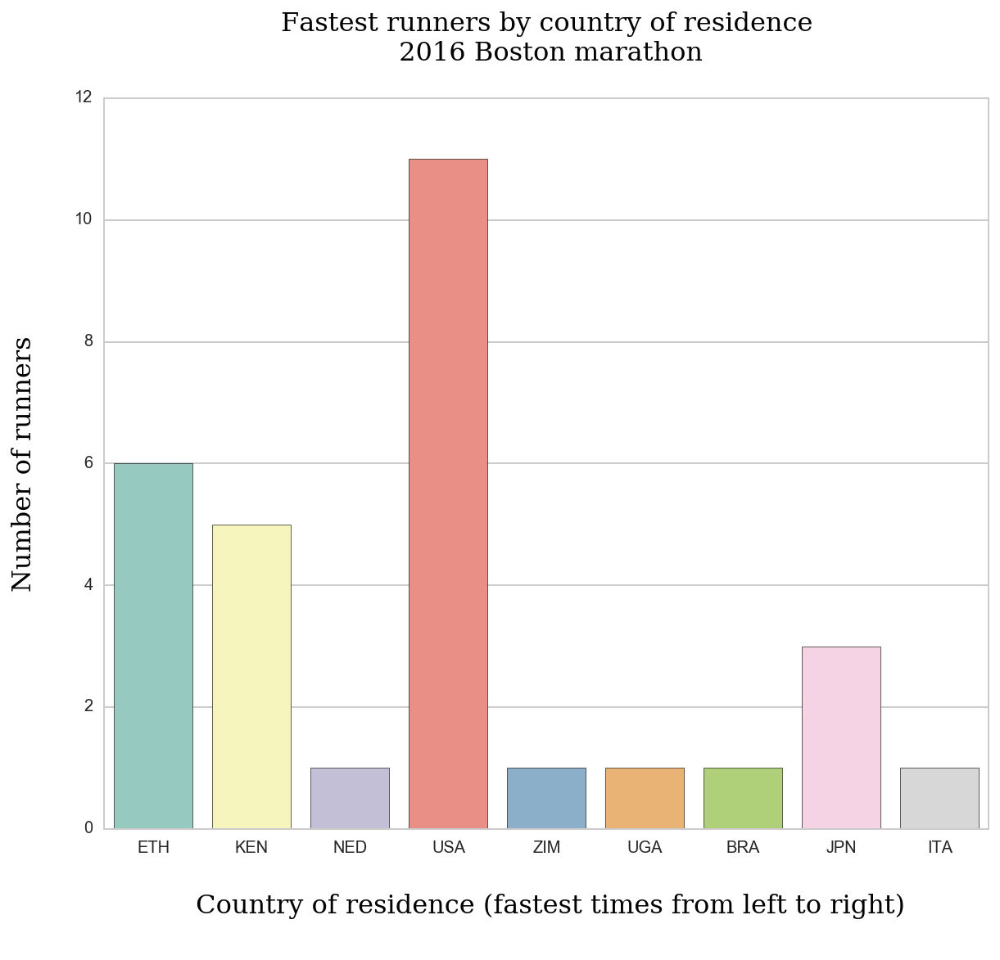

In [29]:
'''Most Dominant runners Male and Female'''
most_dominant_all=boston_2016.groupby(['official_time', 'country_res']).size().reset_index(
                            ).sort_values(by='official_time', ascending=True).head(30)

fig = plt.figure(figsize=(10,8))
ax = fig.gca()

ax = sns.countplot(x="country_res", data=most_dominant_all, palette='Set3')
plt.title('Fastest runners by country of residence\n 2016 Boston marathon\n', fontdict=font)
plt.ylabel('Number of runners\n', fontdict=font)
plt.xlabel('\n Country of residence (fastest times from left to right)\n', fontdict=font)
plt.legend(loc='best')

plt.subplots_adjust(left=0.15)
fig.savefig('../graphs/fastest_runners_all.pdf')
plt.show()

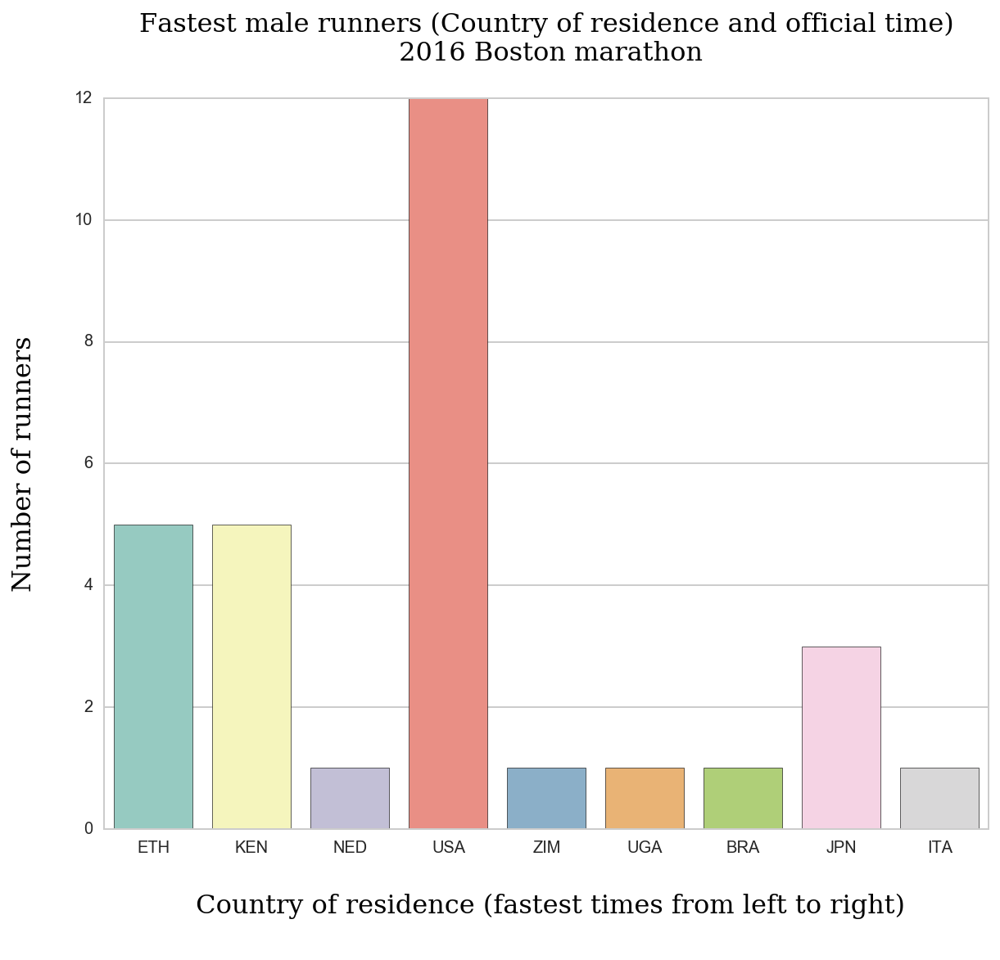

In [30]:
'''Most Dominant runners Male '''
most_dominant_male=boston_2016[bost_mal].groupby(['official_time', 'country_res']).size().reset_index(
                            ).sort_values(by='official_time', ascending=True).head(30)


fig = plt.figure(figsize=(10,8))
ax = fig.gca()

ax = sns.countplot(x="country_res", data=most_dominant_male, palette='Set3')

plt.title('Fastest male runners (Country of residence and official time)\n 2016 Boston marathon\n', fontdict=font)
plt.ylabel('Number of runners\n', fontdict=font)
plt.xlabel('\n Country of residence (fastest times from left to right)\n', fontdict=font)
plt.legend(loc='best')

plt.subplots_adjust(left=0.15)
# fig.savefig('../graphs/fastest_runners_all.pdf')
plt.show()

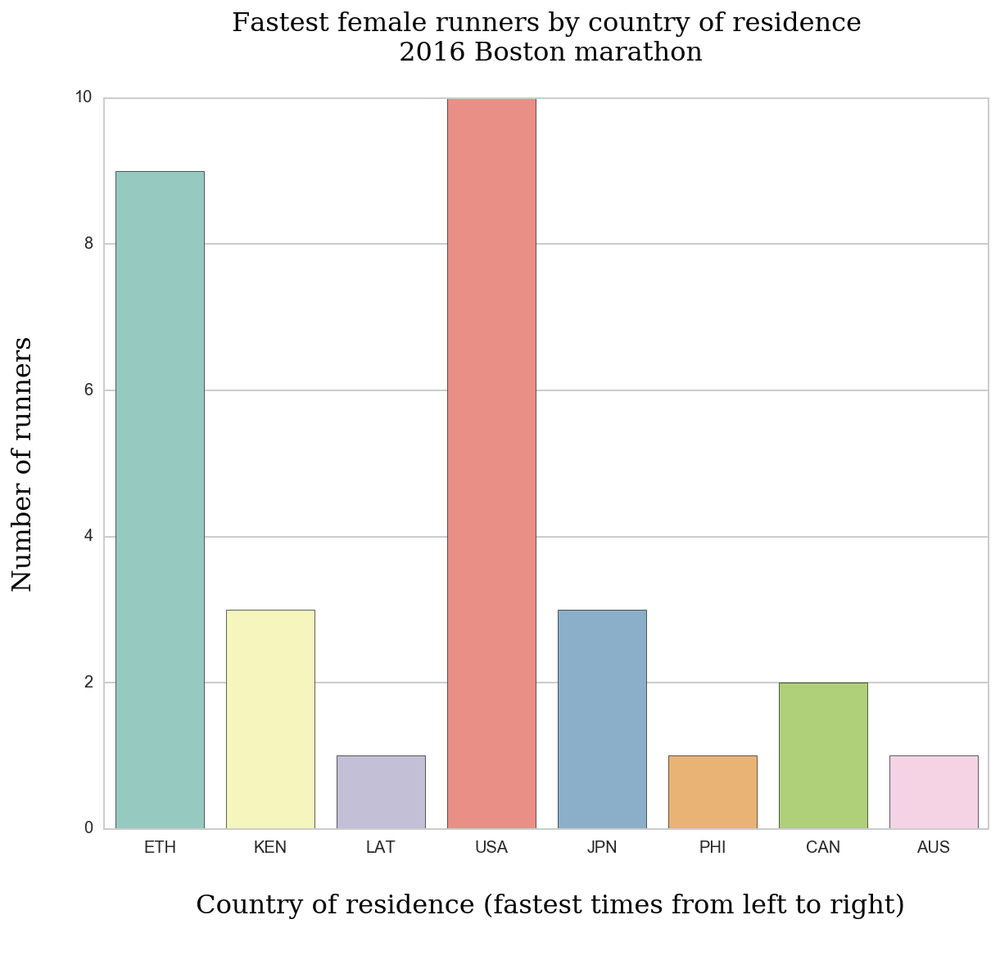

In [31]:
'''Most Dominant runners Male '''
most_dominant_female=boston_2016[bost_fem].groupby(['official_time', 'country_res']).size().reset_index(
                            ).sort_values(by='official_time', ascending=True).head(30)

fig = plt.figure(figsize=(10,8))
ax = fig.gca()

ax = sns.countplot(x="country_res", data=most_dominant_female, palette='Set3')

plt.title('Fastest female runners by country of residence\n 2016 Boston marathon\n', fontdict=font)
plt.ylabel('Number of runners\n', fontdict=font)
plt.xlabel('\n Country of residence (fastest times from left to right)\n', fontdict=font)
plt.legend(loc='best')

plt.subplots_adjust(left=0.15)
# fig.savefig('../graphs/fastest_runners_all.pdf')
plt.show()

### The Most dominant country of residence by male and female are Ethiopia and Kenya. They are follow by The Netherlands and The United States of America for male runners, and by Latvia and the United States for female runners

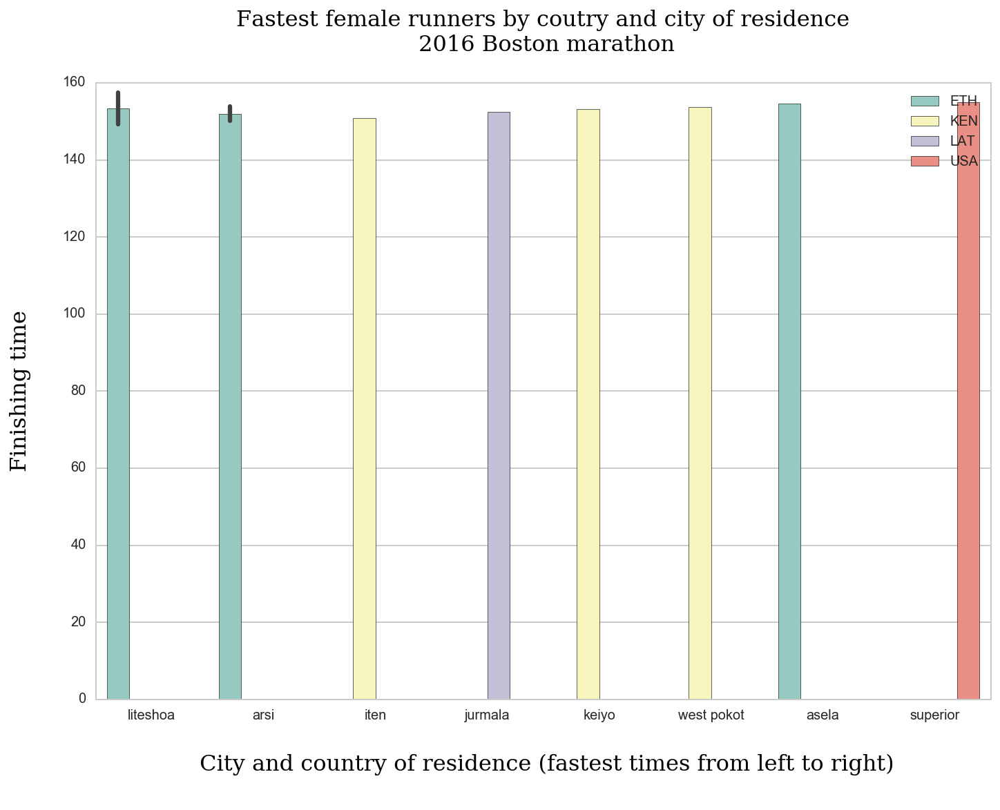

In [32]:
'''Most Dominant runners female by city '''
most_dominant_fem_cit = boston_2016[bost_fem].groupby(['official_time', 'city', 
                    'country_res'])[['bib_number']].count().reset_index().sort_values(by='official_time',
                     ascending=True).head(10)
fig = plt.figure(figsize=(12,8))
ax = fig.gca()

sns.barplot(x="city", y="official_time", hue="country_res", data=most_dominant_fem_cit, palette='Set3')

plt.title('Fastest female runners by coutry and city of residence\n 2016 Boston marathon\n', fontdict=font)
plt.ylabel('Finishing time\n', fontdict=font)
plt.xlabel('\n City and country of residence (fastest times from left to right)\n', fontdict=font)
plt.legend(loc='best')

plt.subplots_adjust(left=0.15)
# fig.savefig('../graphs/fastest_runners_all.pdf')
plt.show()

In [33]:
most_dominant_fem_cit

,official_time,city,country_res,bib_number
0,149.316667,liteshoa,ETH,1
1,150.050000,arsi,ETH,1
2,150.833333,iten,KEN,1
3,152.466667,jurmala,LAT,1
4,153.216667,keiyo,KEN,1
5,153.666667,west pokot,KEN,1
6,153.933333,arsi,ETH,1
7,154.633333,asela,ETH,1
8,155.000000,superior,USA,1
9,157.516667,liteshoa,ETH,1


### Female Runners from the cities of Litheshoa, Arsi in Ethiopia are the fastest runners. They are followed by runners from Iten in Kenya, Jurmala in Latvia, Keiyo and West Pokot in Kenya, Asela in Ethiopia and Superior in The United States

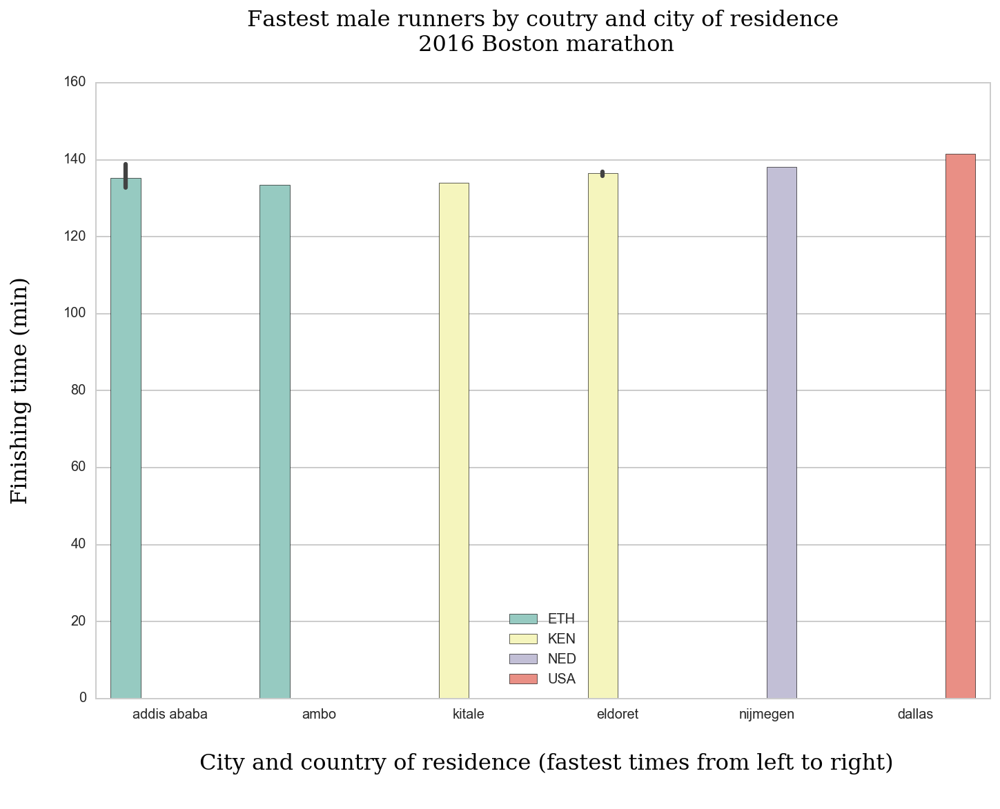

In [34]:
'''Most Dominant runners male by city '''
most_dominant_mal_cit = boston_2016[bost_mal].groupby(['official_time', 'city', 
                    'country_res'])[['bib_number']].count().reset_index().sort_values(by='official_time',
                     ascending=True).head(10)
fig = plt.figure(figsize=(12,8))
ax = fig.gca()

sns.barplot(x="city", y="official_time", hue="country_res", data=most_dominant_mal_cit, palette='Set3')

plt.title('Fastest male runners by coutry and city of residence\n 2016 Boston marathon\n', fontdict=font)
plt.ylabel('Finishing time (min)\n', fontdict=font)
plt.xlabel('\n City and country of residence (fastest times from left to right)\n', fontdict=font)
plt.legend(loc='best')

plt.subplots_adjust(left=0.15)
# fig.savefig('../graphs/fastest_runners_all.pdf')
plt.show()

In [35]:
most_dominant_mal_cit

,official_time,city,country_res,bib_number
0,132.750000,addis ababa,ETH,1
1,133.533333,ambo,ETH,1
2,134.033333,addis ababa,ETH,1
3,134.083333,kitale,KEN,1
4,135.750000,eldoret,KEN,1
5,136.716667,eldoret,KEN,1
6,136.866667,eldoret,KEN,1
7,138.083333,nijmegen,NED,1
8,138.766667,addis ababa,ETH,1
9,141.616667,dallas,USA,1


### Male Runners from the cities of Addis Ababa and Ambo in Ethiopia are the faster runners, they are followed by runners from Kitale and Eldoret in Kenya. These runners are followed by runners from Nijmegen in The Netherlands, and Dallas in the United Sates are the fastest runners


### Relationship official and projected times and age

In [36]:
'''Dont delete packages'''
from altair import *
from altair import Chart, Color, Scale
from palettable import colorbrewer as cb 
from palettable.colorbrewer.sequential import Blues_8
from altair import Chart, X, Y, Scale

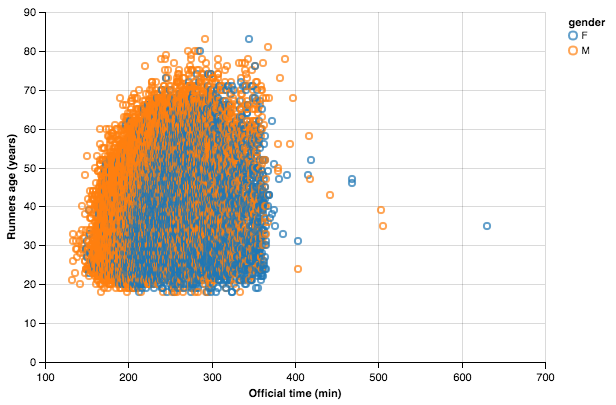

In [37]:

c = Chart(boston_2016).mark_point().encode(
    X('official_time:Q', scale=Scale(domain=(100, 700)), 
      axis=Axis(title='Official time (min)')),
    Y('age:Q', 
      axis=Axis(title='Runners age (years)')),
    color='gender:N',
)
c


Male runners in between the ages of 20 and to 25 have the fastest finishing times, when compared with women within the same age range. Only one female runner has the longest finishing time (over 600 minutes) followed y 2 males runners with over 500 minutes.

In general male and female runners between the ages of 20 to 60 finished the run within 120 minutes and 360 minutes


In [38]:
exc_zero_time_16 = boston_2016[(boston_2016['proj_time']!= 0.000000)]
exc_zero_time_16.shape

(26521, 25)

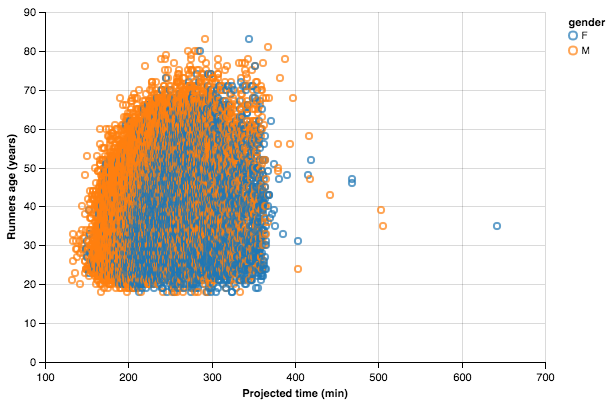

In [39]:
c = Chart(exc_zero_time_16).mark_point().encode(
    X('proj_time:Q', scale=Scale(domain=(100, 700)),
      axis=Axis(title='Projected time (min)')),
    Y('age:Q',
      axis=Axis(title='Runners age (years)')),
    color='gender:N',
)
c


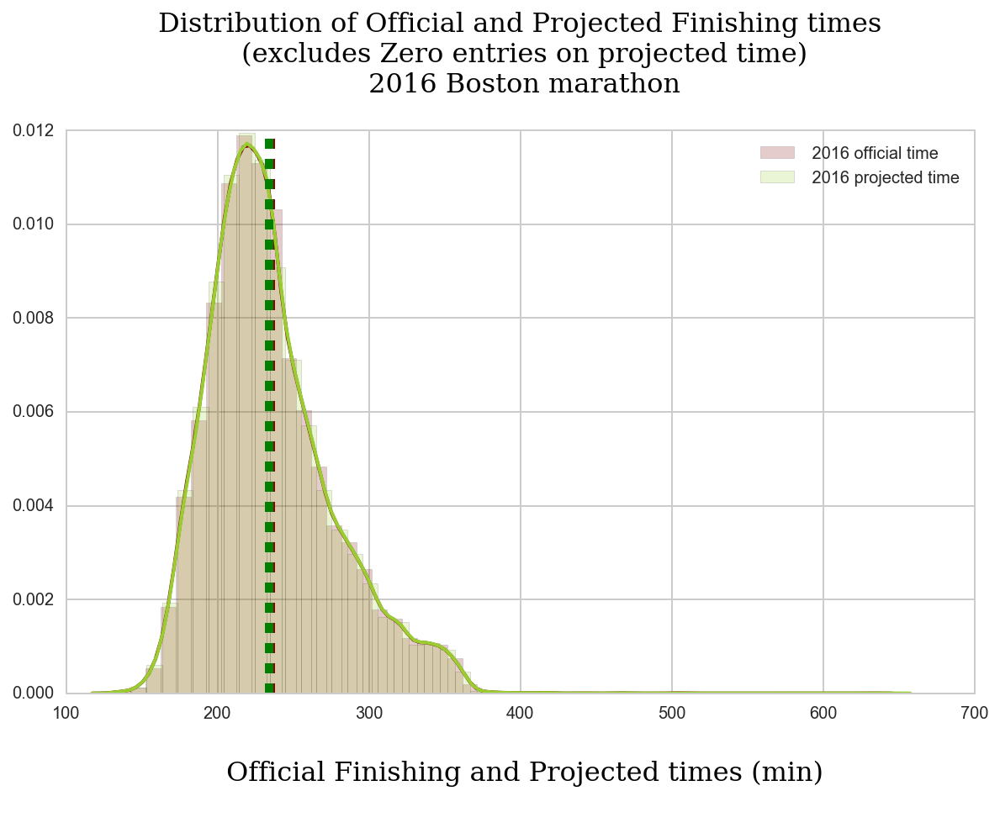

In [40]:
fig = plt.figure(figsize=(10,6))
ax = fig.gca()

'''2016 official time'''
dist = sns.distplot(boston_2016.official_time, ax=ax, color='maroon', 
                                 hist_kws={'alpha':0.2}, kde_kws={'linewidth':2}, label=" 2016 official time")
dist.axvline(np.mean(boston_2016.official_time), lw=5, c='darkred', ls='dashed')

'''2016 projected time'''
dist = sns.distplot(boston_2016[(boston_2016['proj_time']!= 0.000000)].proj_time, 
                    ax=ax, color='yellowgreen', 
                    hist_kws={'alpha':0.2}, 
                    kde_kws={'linewidth':2}, 
                    label=" 2016 projected time")
dist.axvline(np.mean(boston_2016.proj_time), lw=5, c='g', ls='dashed')

plt.title('Distribution of Official and Projected Finishing times\n (excludes Zero entries on projected time)\n 2016 Boston marathon\n', fontdict=font)
# plt.ylabel('Time in minutes\n', fontdict=font)
plt.xlabel('\n Official Finishing and Projected times (min)\n', fontdict=font)
plt.legend(loc='best')

plt.subplots_adjust(left=0.15)
#fig.savefig('../graphs/rank_gender_time.pdf')
plt.show()


## If 0 is excluded from the projected time there is no difference between the projected and the official finishing times for the 2016 marathon runners

## Top 15 male and females
---


Male:
1. Hayle, Lemi Berhanu	2:12:45	 	ETH	 
2. Desisa, Lelisa	2:13:32	 	ETH	 
3. Tsegay, Yemane Adhane	2:14:02	 	ETH	 
4. Korir, Wesley	2:14:05	 	KEN	 
5. Lonyangata, Paul	2:15:45	 	KEN	 
6. Kitwara, Sammy	2:16:43	 	KEN	 
7. Chebogut, Stephen	2:16:52	 	KEN	 
8. Nageeye, Abdi	2:18:05	 	NED	 
9. Feleke, Getu	2:18:46	 	ETH	 
10. Hine, Zachary	2:21:37	TX	USA	 
11. Nyasango, Cutbert	2:22:02	 	ZIM	 
12. Mekonnen, Tsegaye	2:22:21	 	ETH	 
13. Burrell, Ian	2:22:22	CO	USA	 
14. Kiprop, Jackson	2:24:44	 	UGA	 
15. Okuti, Harbert

Female
1. Baysa, Atsede	2:29:19	 	ETH	 
2. Tsegaye, Tirfi	2:30:03	 	ETH	 
3. Chepkirui, Joyce	2:30:50	 	KEN	 
4. Prokopcuka, Jelena	2:32:28	 	LAT	 
5. Kipketer, Valentine	2:33:13	 	KEN	 
6. Daniel, Flomena Cheyech	2:33:40	 	KEN	 
7. Deba, Buzunesh	2:33:56	 	ETH	 
8. Tola, Fate	2:34:38	 	ETH	 
9. Spence Gracey, Neely	2:35:00	CO	USA	 
10. Daska, Mamitu	2:37:31	 	ETH	 
11. Crouch, Sarah	2:37:36	NC	USA	 
12. Shimokado, Miharu	2:39:21	 	JPN	 
13. Beriso, Amane	2:39:38	 	ETH	 
14. Gelana, Tiki	2:42:38	 	ETH	 
15. Bekele, Tadelech

In [41]:
'''Lets keep these names'''
top_15_males = boston_2016[(boston_2016['gender'] == "M")].sort_values(by='official_time', ascending=True).head(15)
top_15_females = boston_2016[(boston_2016['gender'] == "F")].sort_values(by='official_time', ascending=True).head(15)

In [42]:
top_15_males.describe()

,age,5_k,10_k,15_k,20_k,half,25_k,30_k,35_k,40_k,pace,proj_time,official_time,rank_overall,rank_over_gender,rank_over_division
count,15.000000,15.000000,15.000000,15.000000,15.000000,15.000000,15.000000,15.000000,15.000000,15.000000,15.000000,15.000000,15.000000,15.000000,15.000000,15.000000
mean,28.066667,15.807778,31.468889,47.331111,63.540000,67.086667,79.734444,95.685556,112.901111,130.343333,5.292222,138.563333,138.563333,8.000000,8.000000,8.000000
std,4.026105,0.079149,0.269027,0.443286,0.657007,0.690215,0.992241,1.744730,2.393588,3.528899,0.160958,4.147983,4.147983,4.472136,4.472136,4.472136
min,20.000000,15.766667,31.333333,47.100000,63.216667,66.733333,79.250000,94.283333,110.400000,125.983333,5.066667,132.750000,132.750000,1.000000,1.000000,1.000000
25%,26.500000,15.766667,31.333333,47.116667,63.233333,66.750000,79.250000,94.750000,110.808333,127.483333,5.150000,134.916667,134.916667,4.500000,4.500000,4.500000
50%,29.000000,15.783333,31.350000,47.133333,63.233333,66.766667,79.283333,95.050000,112.316667,129.116667,5.266667,138.083333,138.083333,8.000000,8.000000,8.000000
75%,31.000000,15.783333,31.350000,47.133333,63.241667,66.783333,79.366667,95.458333,114.258333,133.583333,5.433333,142.191667,142.191667,11.500000,11.500000,11.500000
max,33.000000,16.050000,32.133333,48.383333,65.183333,68.800000,82.266667,99.750000,117.866667,136.366667,5.533333,144.766667,144.766667,15.000000,15.000000,15.000000


In [43]:
top_15_females.describe()

,age,5_k,10_k,15_k,20_k,half,25_k,30_k,35_k,40_k,pace,proj_time,official_time,rank_overall,rank_over_gender,rank_over_division
count,15.000000,15.000000,15.000000,15.000000,15.000000,15.000000,15.000000,15.000000,15.000000,15.000000,15.000000,15.000000,15.000000,15.000000,15.000000,15.000000
mean,28.266667,18.368889,36.348889,54.087778,72.021111,75.881111,89.976667,108.511111,128.055556,147.057778,5.943333,155.612222,155.612222,87.266667,8.000000,8.000000
std,4.131182,0.005864,0.009894,0.166365,0.511513,0.601251,1.025775,1.929076,3.155901,4.130197,0.172493,4.472555,4.472555,62.028181,4.472136,4.472136
min,23.000000,18.366667,36.333333,53.983333,71.733333,75.533333,89.200000,106.533333,124.483333,141.816667,5.700000,149.316667,149.316667,29.000000,1.000000,1.000000
25%,25.500000,18.366667,36.350000,54.000000,71.750000,75.533333,89.250000,106.766667,125.208333,144.266667,5.833333,152.841667,152.841667,46.500000,4.500000,4.500000
50%,28.000000,18.366667,36.350000,54.000000,71.750000,75.550000,89.466667,108.016667,127.050000,145.816667,5.900000,154.633333,154.633333,65.000000,8.000000,8.000000
75%,30.000000,18.366667,36.350000,54.075000,71.950000,75.891667,90.641667,109.925000,130.075000,149.916667,6.050000,158.475000,158.475000,110.000000,11.500000,11.500000
max,39.000000,18.383333,36.366667,54.400000,73.000000,77.016667,91.850000,112.466667,134.150000,154.516667,6.283333,164.333333,164.333333,247.000000,15.000000,15.000000


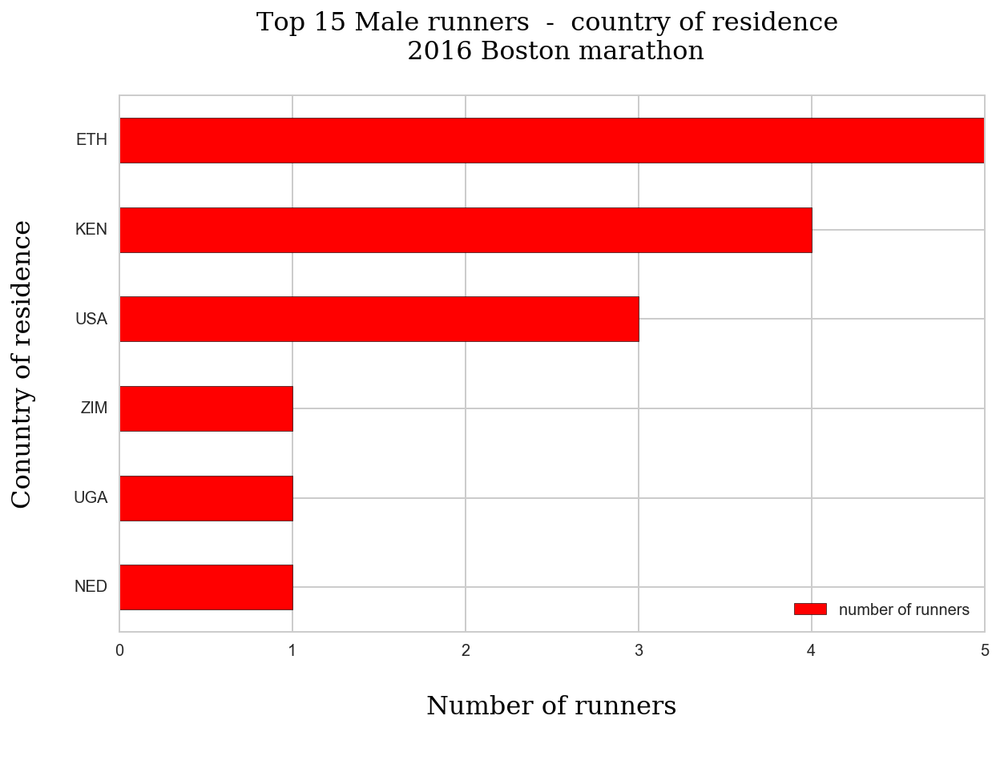

In [44]:
'''Countries'''
fig = plt.figure(figsize=(10,6))
ax = fig.gca()
top_15_males.groupby('country_res')['bib_number'].count().sort_values(ascending
            =True).plot(kind='barh', color='r', label='number of runners', ax=ax)

plt.title('Top 15 Male runners  -  country of residence \n 2016 Boston marathon\n', fontdict=font)
plt.ylabel('Conuntry of residence\n', fontdict=font)
plt.xlabel('\n Number of runners \n', fontdict=font)
plt.legend(loc='best')
plt.subplots_adjust(left=0.15)
#fig.savefig('../graphs/rank_gender_time.pdf')
plt.show()
plt.show()
                                                           

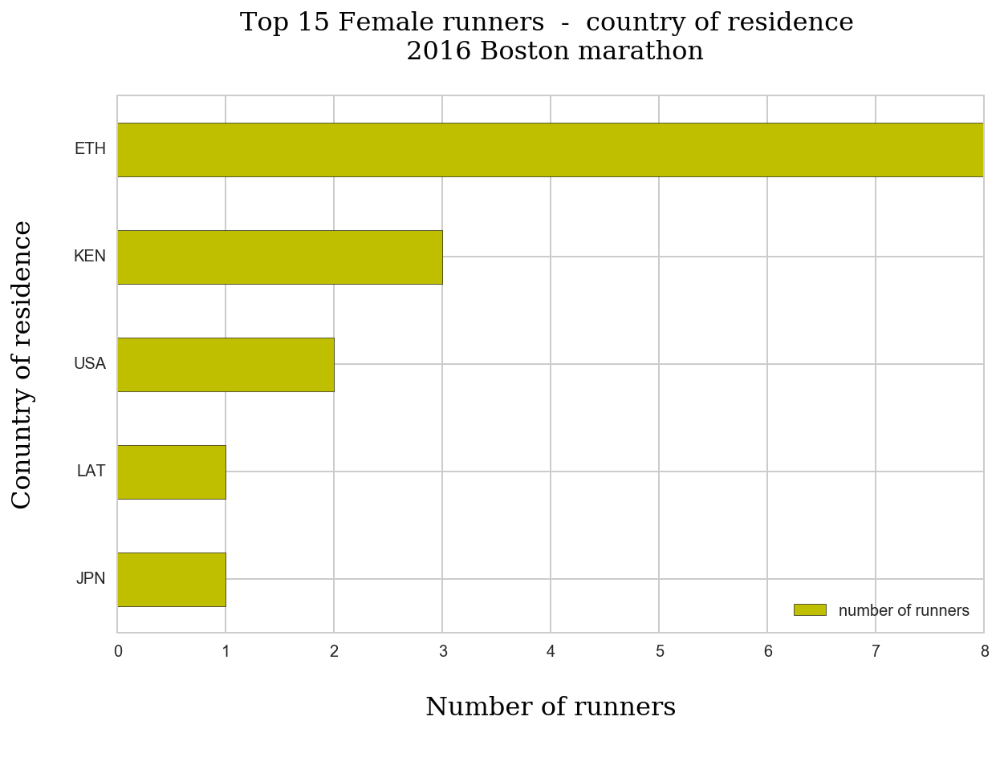

In [45]:
'''Countries'''
fig = plt.figure(figsize=(10,6))
ax = fig.gca()
top_15_females.groupby('country_res')['bib_number'].count().sort_values(ascending
            =True).plot(kind='barh', color='y', label='number of runners', ax=ax)

plt.title('Top 15 Female runners  -  country of residence \n 2016 Boston marathon\n', fontdict=font)
plt.ylabel('Conuntry of residence\n', fontdict=font)
plt.xlabel('\n Number of runners \n', fontdict=font)
plt.legend(loc='best')
plt.subplots_adjust(left=0.15)
#fig.savefig('../graphs/rank_gender_time.pdf')
plt.show()
plt.show()

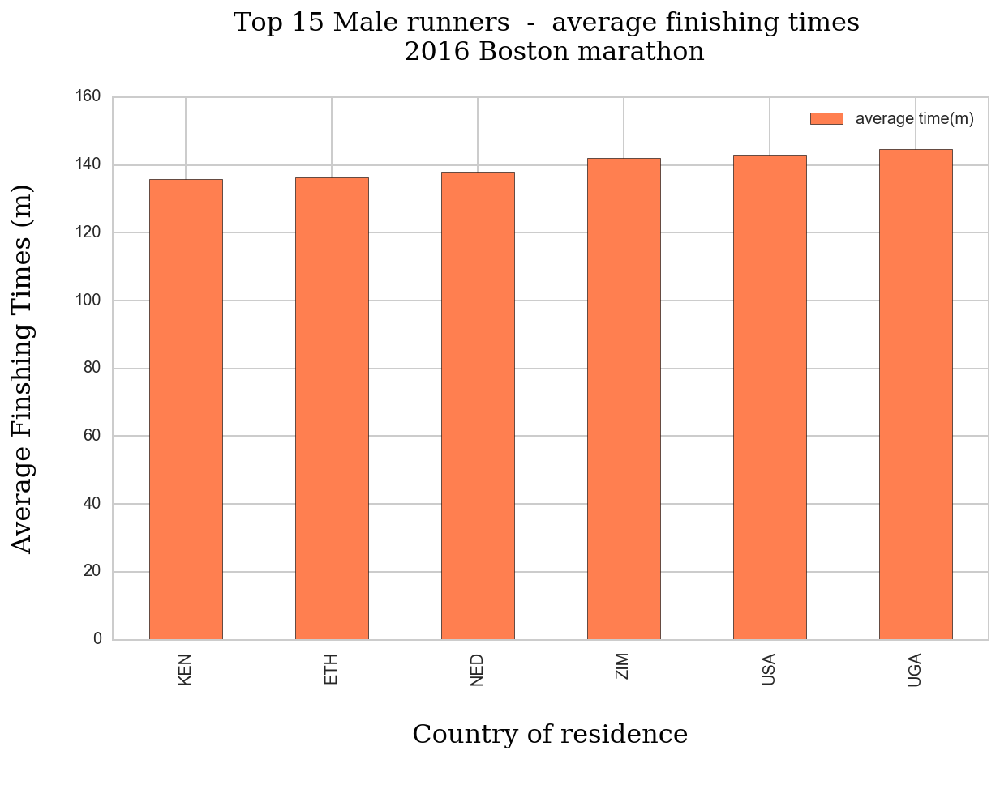

In [46]:
'''Times'''
fig = plt.figure(figsize=(10,6))
ax = fig.gca()
top_15_males.groupby('country_res')['official_time'].mean().sort_values(ascending
            =True).plot(kind='bar', color='coral', label='average time(m)', ax=ax)

plt.title('Top 15 Male runners  -  average finishing times \n 2016 Boston marathon\n', fontdict=font)
plt.ylabel('Average Finshing Times (m)\n', fontdict=font)
plt.xlabel('\n Country of residence \n', fontdict=font)
plt.legend(loc='best')
plt.subplots_adjust(left=0.15)
#fig.savefig('../graphs/rank_gender_time.pdf')
plt.show()
plt.show()

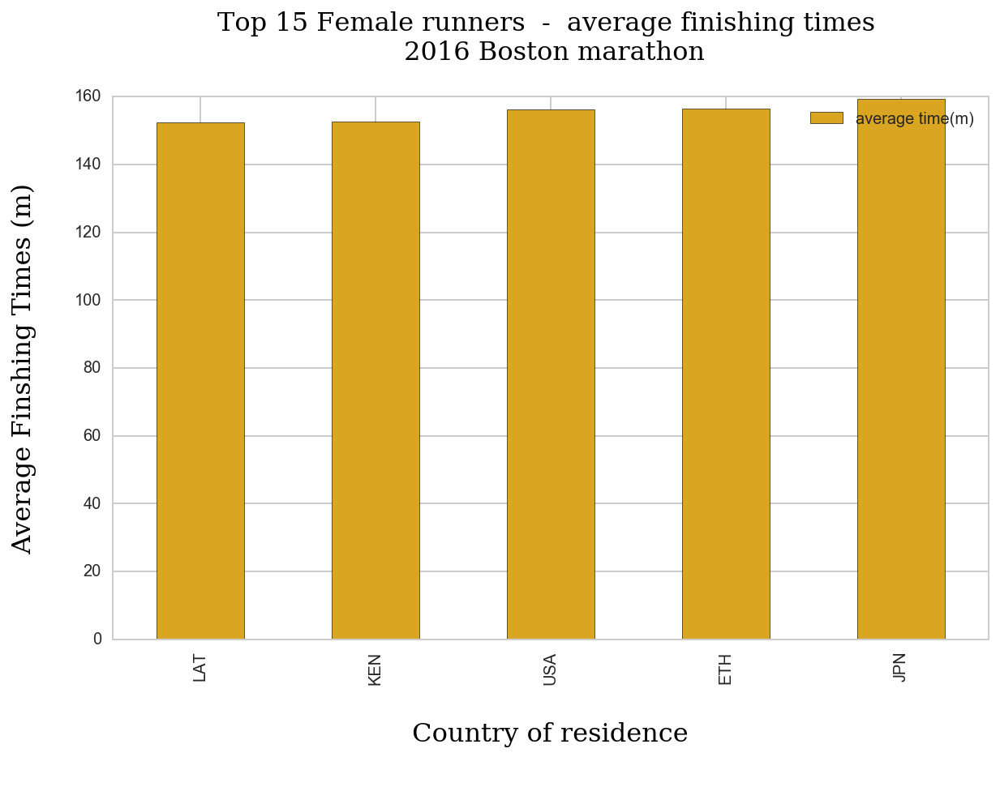

In [47]:
'''Times'''
fig = plt.figure(figsize=(10,6))
ax = fig.gca()
top_15_females.groupby('country_res')['official_time'].mean().sort_values(ascending
            =True).plot(kind='bar', color='goldenrod', label='average time(m)', ax=ax)

plt.title('Top 15 Female runners  -  average finishing times \n 2016 Boston marathon\n', fontdict=font)
plt.ylabel('Average Finshing Times (m)\n', fontdict=font)
plt.xlabel('\n Country of residence \n', fontdict=font)
plt.legend(loc='best')
plt.subplots_adjust(left=0.15)
#fig.savefig('../graphs/rank_gender_time.pdf')
plt.show()
plt.show()

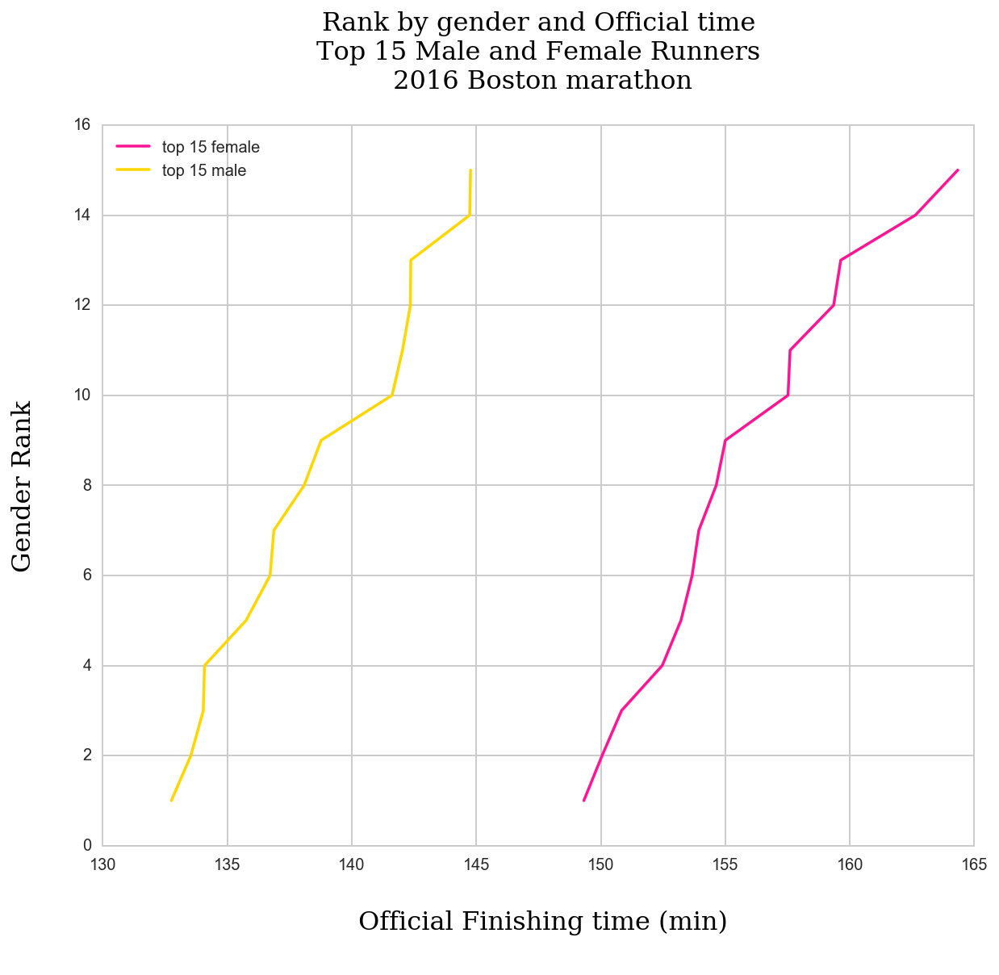

In [48]:
fig = plt.figure(figsize=(10,8))
ax = fig.gca()
''''''
sns.set_style("whitegrid")
plt.plot(top_15_females.official_time, top_15_females.rank_over_gender, color='deeppink', label='top 15 female')
plt.plot(top_15_males.official_time, top_15_males.rank_over_gender, color='gold', label='top 15 male')

plt.title('Rank by gender and Official time\n Top 15 Male and Female Runners \n 2016 Boston marathon\n', fontdict=font)
plt.ylabel('Gender Rank\n', fontdict=font)
plt.xlabel('\n Official Finishing time (min)\n', fontdict=font)
plt.legend(loc='best')

plt.subplots_adjust(left=0.15)
# fig.savefig('../graphs/rank_gender_time.pdf')
plt.show()



## Who was faster ?
---

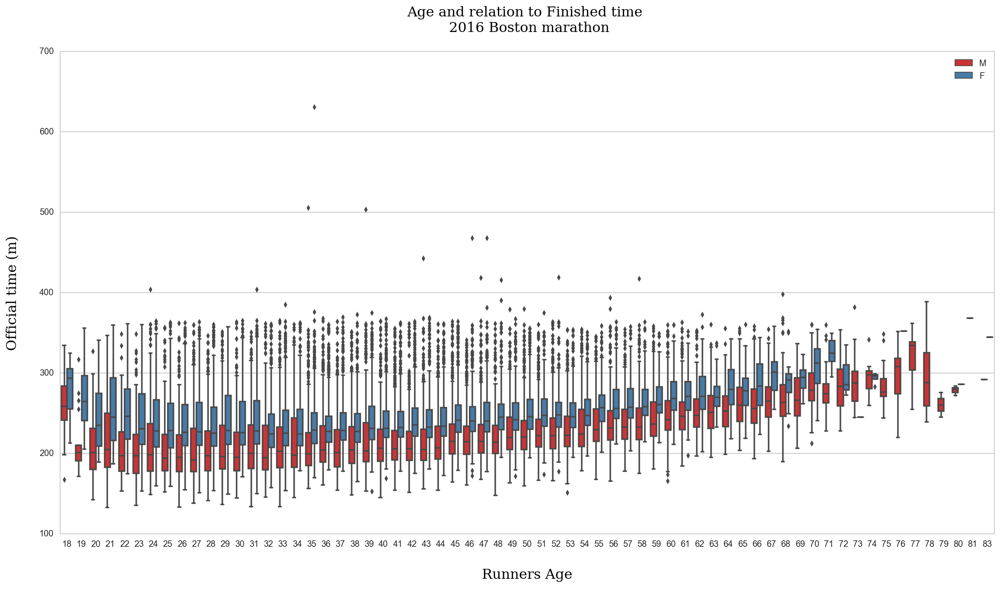

In [49]:
fig = plt.figure(figsize=(20,10))
ax = fig.gca()
sns.boxplot(x="age", y="official_time", hue="gender", data=boston_2016, palette="Set1", ax=ax)

plt.title('Age and relation to Finished time \n 2016 Boston marathon\n', fontdict=font)
plt.ylabel('Official time (m)\n', fontdict=font)
plt.xlabel('\n Runners Age \n', fontdict=font)
plt.legend(loc='best')

plt.subplots_adjust(left=0.15)
#fig.savefig('../graphs/rank_gender_time.pdf')
plt.show()

21, 26, 31 and 33 year old male runners recorded the fastest finishing times, and 29, 31 and 27 years old female runners recorded the fastest finishing times

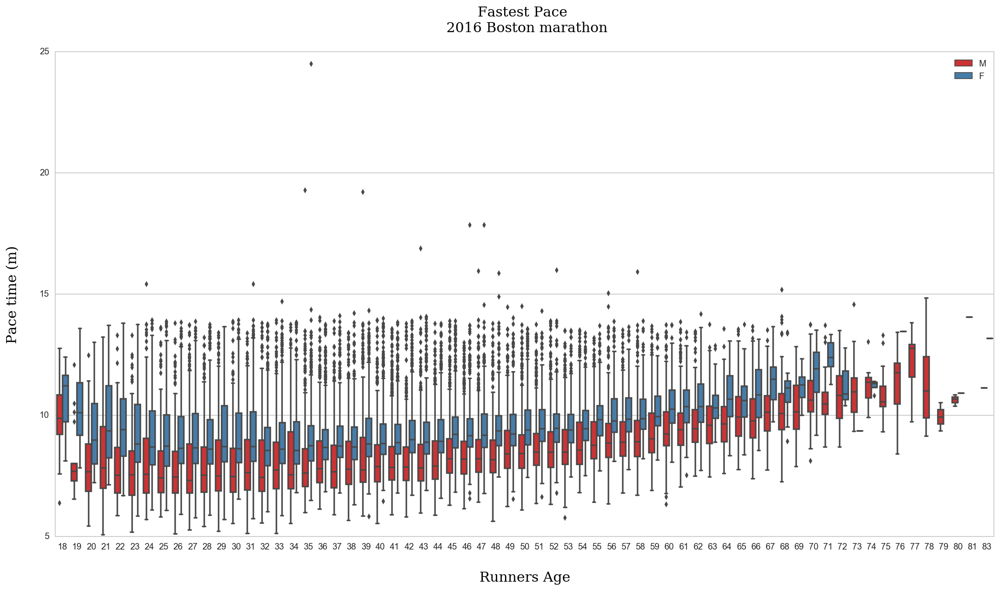

In [50]:
fig = plt.figure(figsize=(20,10))
ax = fig.gca()
sns.boxplot(x="age", y="pace", hue="gender", data=boston_2016, palette="Set1", ax=ax)

plt.title('Fastest Pace \n 2016 Boston marathon\n', fontdict=font)
plt.ylabel('Pace time (m)\n', fontdict=font)
plt.xlabel('\n Runners Age \n', fontdict=font)
plt.legend(loc='best')

plt.subplots_adjust(left=0.15)
#fig.savefig('../graphs/rank_gender_time.pdf')
plt.show()

21, 26, 31,33 year old Male runners had the fastest pace in the marathon, whereas a 23, 27 and 29 year old female runner had the fastest pace 


## What about the split?
---
- A common strategy for runners is to run the second half of the race faster than the first half, this is considered as a **Negative Split**. On the other hand a **Positive Split** means that a runner decides to run the first half faster than the second half. 
- Splits: A race’s total time divided into smaller parts (usually miles), is known as the splits. If a runner has an even split, it means they ran the same pace through the entire race.
- I am following this link http://www.hillrunner.com/jim2/id209.html
- I am exploring this idea in here:

In [51]:
boston_2016['split_ratio'] = (boston_2016['official_time'] - boston_2016['half'])/(boston_2016['half'])

- Negative split = Second part of race was runned faster than the first part, in this case a value less than 1
- Positive split = First part of the race was runned faster than the second half, in this case a value grater than 1

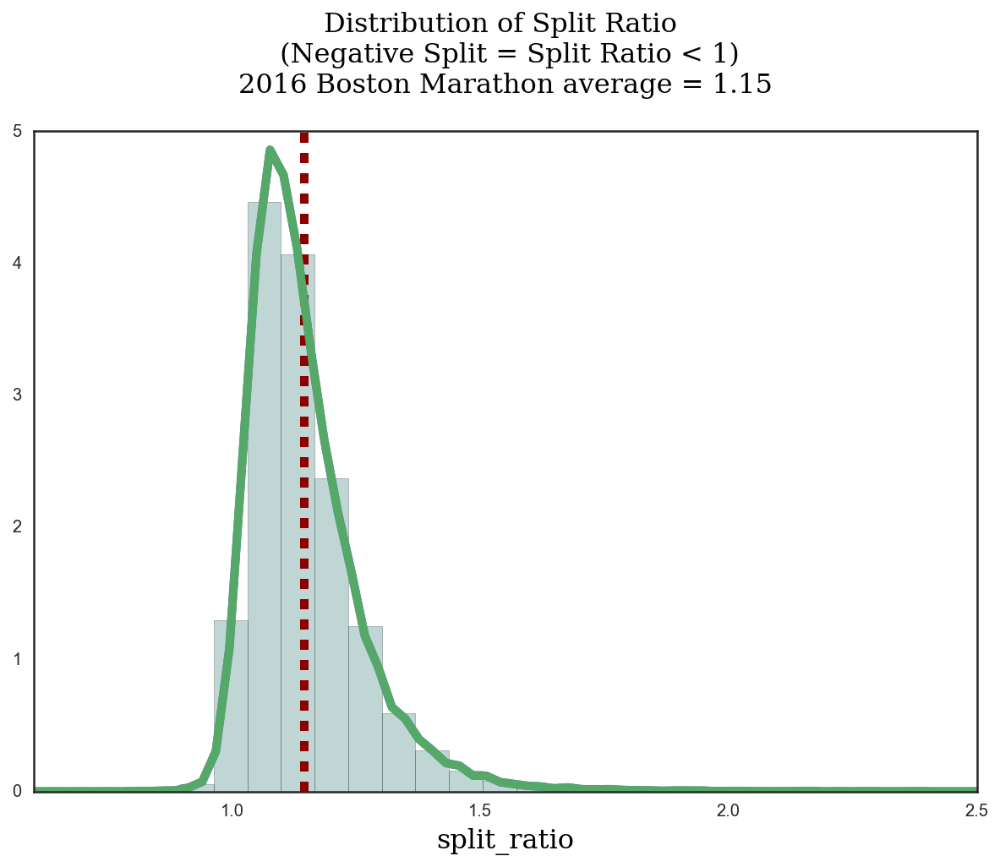

In [52]:
histogram_plotter('Split Ratio \n (Negative Split = Split Ratio < 1)\n2016 Boston Marathon', boston_2016[boston_2016.half > 0].split_ratio)
plt.xlim([0.6, 2.5])
plt.show()

In [53]:
'''Male runners with the top 15 best fihishing times and split ration < 1'''
names_male = boston_2016[(boston_2016.split_ratio < 1 ) & (boston_2016.gender == "M") 
           ].sort_values(by=['official_time'], ascending=[True]).head(10)

names_male[['name_16', 'country_res', 'official_time','split_ratio', 'gender']]

,name_16,country_res,official_time,split_ratio,gender
0,"Hayle, Lemi Berhanu",ETH,132.750000,0.988764,M
38,"Ash, Alan",USA,151.266667,0.988171,M
63,"Kowalski, Justin",USA,154.583333,0.998492,M
121,"Venable, Bronson",USA,159.316667,0.998954,M
181,"Kaczmarek, Bruce",USA,162.466667,0.995496,M
196,"Quick, Michael",USA,162.950000,0.993272,M
363,"Lloyd, James",USA,167.666667,0.964077,M
366,"Bentley, Justin",USA,167.750000,0.998213,M
411,"Powell, Richard J.",USA,168.800000,0.991740,M
416,"Sarkovics, Rodney T",USA,168.883333,0.968720,M


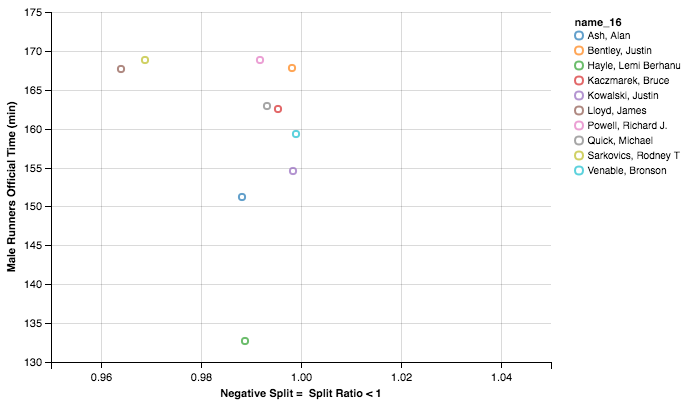

In [54]:
c = Chart(names_male).mark_point().encode(
    X('split_ratio:Q', scale=Scale(domain=(0.95, 1.05)),
      axis=Axis(title='Negative Split =  Split Ratio < 1')),
    Y('official_time:Q',scale=Scale(domain=(130, 175)),
      axis=Axis(title='Male Runners Official Time (min)')),
    color='name_16:N',
)
c

In [55]:
'''Female runners with the top 15 best fihishing times and split ration < 1'''
names_fem = boston_2016[(boston_2016.split_ratio < 1 ) & (boston_2016.gender == "F") 
           ].sort_values(by=['official_time'], ascending=[True]).head(10)

names_fem[['name_16', 'country_res', 'official_time','split_ratio', 'gender']]

,name_16,country_res,official_time,split_ratio,gender
28,"Baysa, Atsede",ETH,149.316667,0.976831,F
32,"Tsegaye, Tirfi",ETH,150.050000,0.986540,F
35,"Chepkirui, Joyce",KEN,150.833333,0.996911,F
866,"Rees, Holly A",USA,174.950000,0.976092,F
935,"Brown, Kayla E.",USA,175.833333,0.993952,F
1013,"O'Meara, Madeleine",USA,176.550000,0.990791,F
1319,"Conlon, Elizabeth",USA,179.050000,0.974816,F
1430,"Berry, Jennifer",USA,179.833333,0.996669,F
1474,"Junqueira, Mariana B.",BRA,180.200000,0.987135,F
1550,"Guisinger, Katie N.",USA,180.750000,0.993933,F


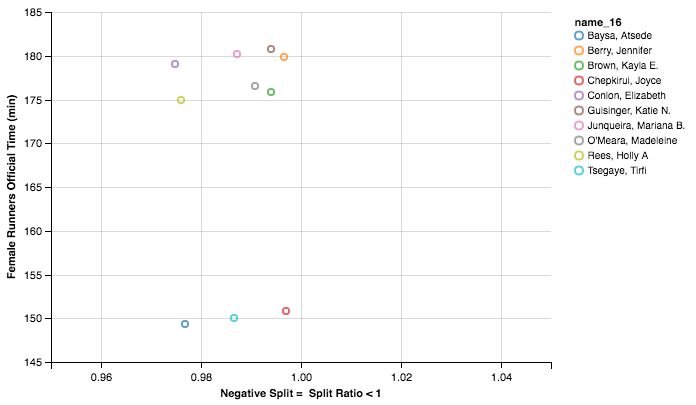

In [56]:
c = Chart(names_fem).mark_point().encode(
    X('split_ratio:Q', scale=Scale(domain=(0.95, 1.05)),
      axis=Axis(title='Negative Split =  Split Ratio < 1')),
    Y('official_time:Q',scale=Scale(domain=(148, 184)),
      axis=Axis(title='Female Runners Official Time (min)')),
    color='name_16:N',
)
c

### Split > 1 and best finishing time

In [57]:
'''Male runners with the top 15 best fihishing times and split ration < 1'''
names_male_1 = boston_2016[(boston_2016.split_ratio >= 1 ) & (boston_2016.gender == "M") 
           ].sort_values(by=['official_time'], ascending=[True]).head(10)

names_male_1[['name_16', 'country_res', 'official_time','split_ratio', 'gender']]

,name_16,country_res,official_time,split_ratio,gender
1,"Desisa, Lelisa",ETH,133.533333,1.000000,M
2,"Tsegay, Yemane Adhane",ETH,134.033333,1.008492,M
3,"Korir, Wesley",KEN,134.083333,1.008238,M
4,"Lonyangata, Paul",KEN,135.750000,1.033200,M
5,"Kitwara, Sammy",KEN,136.716667,1.047678,M
6,"Chebogut, Stephen",KEN,136.866667,1.049414,M
7,"Nageeye, Abdi",NED,138.083333,1.067632,M
8,"Feleke, Getu",ETH,138.766667,1.078901,M
9,"Hine, Zachary",USA,141.616667,1.084130,M
10,"Nyasango, Cutbert",ZIM,142.033333,1.126778,M


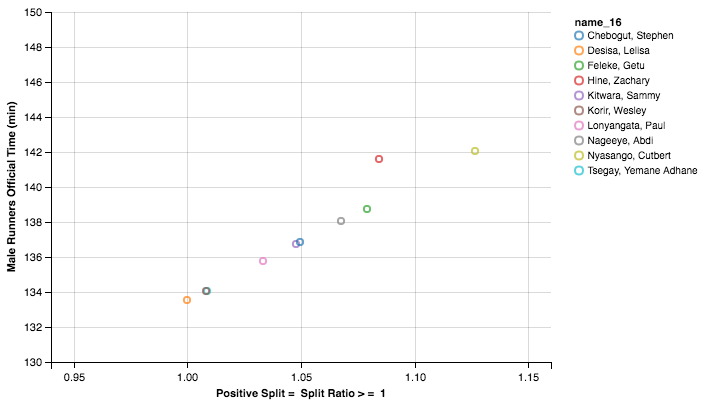

In [58]:
c = Chart(names_male_1).mark_point().encode(
    X('split_ratio:Q', scale=Scale(domain=(0.95, 1.15)),
      axis=Axis(title='Positive Split =  Split Ratio > =  1')),
    Y('official_time:Q',scale=Scale(domain=(130, 150)),
      axis=Axis(title='Male Runners Official Time (min)')),
    color='name_16:N',
)
c

In [59]:
'''Female runners with the top 15 best fihishing times and split ration < 1'''
names_fem_1 = boston_2016[(boston_2016.split_ratio >= 1 ) & (boston_2016.gender == "F") 
           ].sort_values(by=['official_time'], ascending=[True]).head(10)

names_fem_1[['name_16', 'country_res', 'official_time','split_ratio', 'gender']]

,name_16,country_res,official_time,split_ratio,gender
43,"Prokopcuka, Jelena",LAT,152.466667,1.006580,F
48,"Kipketer, Valentine",KEN,153.216667,1.028464,F
52,"Daniel, Flomena Cheyech",KEN,153.666667,1.033973,F
55,"Deba, Buzunesh",ETH,153.933333,1.037503,F
64,"Tola, Fate",ETH,154.633333,1.047220,F
68,"Spence Gracey, Neely",USA,155.000000,1.012551,F
93,"Daska, Mamitu",ETH,157.516667,1.085393,F
96,"Crouch, Sarah",USA,157.600000,1.046310,F
122,"Shimokado, Miharu",JPN,159.350000,1.069033,F
125,"Beriso, Amane",ETH,159.633333,1.113416,F


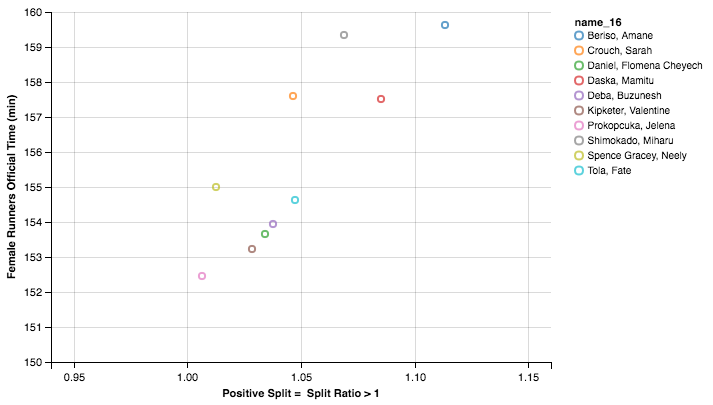

In [60]:
c = Chart(names_fem_1).mark_point().encode(
    X('split_ratio:Q', scale=Scale(domain=(0.95, 1.15)),
      axis=Axis(title='Positive Split =  Split Ratio > 1')),
    Y('official_time:Q',scale=Scale(domain=(150, 160)),
      axis=Axis(title='Female Runners Official Time (min)')),
    color='name_16:N',
)
c

### Split Ratio analysis
1. **Male** runneres with the best finishing time used the positive split strategy (run first half faster than the second half), with the exception of marathon winner Hayle, Lemi Berhanu	who used a negative split strategy (run second part of race was run faster than the first part) and Desisa, Lelisa who didn't use any of the strategy, in fact he seemed to run the first part and second part of the marathon in the same pace

2. **Female** runners that used the negative split strategy (run second part of race was run faster than the first part) includes the top 3 runners (Baysa, Atsede, Tsegaye, Tirfi and Chepkirui, Joyce). On the other hand, the rest of the top 15 female runners (runners with the best finishing time) used the postive split strategy (run first half faster than the second half)


## Elevation - visualizing the race
---

In [61]:
boston_elev = pd.read_csv('../raw_data/route_1931307.csv')
print boston_elev.shape
boston_elev.head(3)

(158, 4)


,Distance from start(meters),elevation(meters),accumulated ascent(meters),accumulated descent(meters)
0,0.00,137.14,0.00,0.0
1,213.39,149.32,0.00,0.0
2,346.91,150.80,12.18,0.0


In [62]:
''' Strategy:
    1. Calculate the elevation at each time point of the race, where time point is 5_k, 10_k
    2. Calculate the accumulated ascendent and descendent elevation at each point'''
## First transform meters to km
## 1 Meter = 0.001 Kilometer
boston_elev['dist_from_start_km'] =  ((boston_elev['Distance from start(meters)']) * (0.001))
# boston_elev.dist_from_start_km.round()

In [63]:
boston_elev.head(2)

,Distance from start(meters),elevation(meters),accumulated ascent(meters),accumulated descent(meters),dist_from_start_km
0,0.00,137.14,0.0,0.0,0.00000
1,213.39,149.32,0.0,0.0,0.21339


In [64]:
''' Strategy:
    1. To Calculate the elevation at each point of the race I am going to average the elevation entries that
    lie within the boundaries of the distance (i.e. for 5 k = elevation that is in the boundaries of 
    5.0 to 5.9) and then pass this value to the 2016 data'''

'''function to calculate elevation at each mark of the race and add it to boston 2016 data'''
def calc_distance(range_1, range_2, col):
    range_1 = float(range_1)
    range_2 = float(range_2)
    
    temp = boston_elev[ (boston_elev.dist_from_start_km >= range_1) & 
                        (boston_elev.dist_from_start_km < range_2)]
    temp [col] = (temp['elevation(meters)'].sum() / temp.shape[0])
    
    boston_2016[col] = temp[col].values[0]
    

In [65]:
'''between 5.0 and 5.9'''
calc_distance(5.0, 5.9, 'elev_5k_meter')

'''between 10.0 and 10.9'''
calc_distance(10.0, 10.9, 'elev_10k_meter')

'''between 15.0 and 15.9'''
calc_distance(15.0, 15.9, 'elev_15k_meter')

'''between 20.0 and 20.9'''
calc_distance(20.0, 20.9, 'elev_20k_meter')

'''Half marathon = 21.0975 kilometres'''
calc_distance(21.0, 21.9, 'elev_half_meter')

'''between 25.0 and 25.9'''
calc_distance(25.0, 25.9, 'elev_25k_meter')

'''between 30.0 and 30.9'''
calc_distance(30.0, 30.9, 'elev_30k_meter')

'''between 35.0 and 35.9'''
calc_distance(35.0, 35.9, 'elev_35k_meter')

'''between 40.0 and 40.9'''
calc_distance(40.0, 40.9, 'elev_40k_meter')

'''The end of the race'''
calc_distance(42.0, 42.9, 'elev_END_meter')

/anaconda/lib/python2.7/site-packages/ipykernel/__main__.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


In [66]:
''' Strategy:
    1. To Calculate the cummulative ascending and descending meters at each mark I am going to use the
        range of distance use the highest range from the calculation before and then sum the values'''

'''function to calculate cummulative meters at each mark of the race and add it to boston 2016 data'''
def calc_cummulative(upper_limit, col):
    upper_limit = float(upper_limit)
    temp = boston_elev[(boston_elev.dist_from_start_km <= upper_limit)] 
    temp [col] = (temp['accumulated ascent(meters)'].sum())
    boston_2016[col] = temp[col].values[0]
    

In [67]:
'''At 5.9'''
calc_cummulative(5.9, 'cumm_asc_5k_met')

'''At 10.9'''
calc_cummulative(10.9, 'cumm_asc_10k_met')

'''At 15.9'''
calc_cummulative(15.9, 'cumm_asc_15k_met')

'''At 20.9'''
calc_cummulative(20.9, 'cumm_asc_20k_met')

'''Half marathon = 21.0975 kilometres'''
calc_cummulative(21.9, 'cumm_asc_half_met')

'''At 25.9'''
calc_cummulative(25.9, 'cumm_asc_25k_met')

'''At 30.9'''
calc_cummulative(30.9, 'cumm_asc_30k_met')

'''At 35.9'''
calc_cummulative(35.9, 'cumm_asc_35k_met')

'''At 40.9 '''
calc_cummulative(40.9, 'cumm_asc_40k_met')

'''End of race '''
calc_cummulative(42.9, 'cumm_asc_END_met')

/anaconda/lib/python2.7/site-packages/ipykernel/__main__.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


In [68]:
''' Strategy:
    1. To Calculate the cummulative ascending and descending meters at each mark I am going to use the
        range of distance use the highest range from the calculation before and then sum the values'''

'''function to calculate cummulative meters at each mark of the race and add it to boston 2016 data'''
def calc_desc_cum(upper_limit, col):
    upper_limit = float(upper_limit)
    temp = boston_elev[(boston_elev.dist_from_start_km <= upper_limit)] 
    temp [col] = (temp['accumulated descent(meters)'].sum())
    boston_2016[col] = temp[col].values[0]

In [69]:
'''At 5.9'''
calc_desc_cum(5.9, 'desc_cumm_5k_met')

'''At 10.9'''
calc_desc_cum(10.9, 'desc_cumm_10k_met')

'''At 15.9'''
calc_desc_cum(15.9, 'desc_cumm_15k_met')

'''At 20.9'''
calc_desc_cum(20.9, 'desc_cumm_20k_met')

'''Half marathon = 21.0975 kilometres'''
calc_desc_cum(21.9, 'desc_cumm_half_met')

'''At 25.9'''
calc_desc_cum(25.9, 'desc_cumm_25k_met')

'''At 30.9'''
calc_desc_cum(30.9, 'desc_cumm_30k_met')

'''At 35.9'''
calc_desc_cum(35.9, 'desc_cumm_35k_met')

'''At 40.9 '''
calc_desc_cum(40.9, 'desc_cumm_40k_met')

'''At end of race '''
calc_desc_cum(42.9, 'desc_cumm_END_met')

/anaconda/lib/python2.7/site-packages/ipykernel/__main__.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


### Let's visualize the race
---

In [70]:
boston_elev.head(3)

,Distance from start(meters),elevation(meters),accumulated ascent(meters),accumulated descent(meters),dist_from_start_km
0,0.00,137.14,0.00,0.0,0.00000
1,213.39,149.32,0.00,0.0,0.21339
2,346.91,150.80,12.18,0.0,0.34691


In [71]:
''' Transforming elevation to meters, and and distance to miles
    1m = 3.28084 foot
    1m = 0.000621371 mile '''

boston_elev['elev_feet'] = (boston_elev['elevation(meters)'] * 3.28084)
boston_elev['dist_from_start_mile'] = (boston_elev['Distance from start(meters)'] * 0.000621371)
boston_elev.head(3)

,Distance from start(meters),elevation(meters),accumulated ascent(meters),accumulated descent(meters),dist_from_start_km,elev_feet,dist_from_start_mile
0,0.00,137.14,0.00,0.0,0.00000,449.934398,0.000000
1,213.39,149.32,0.00,0.0,0.21339,489.895029,0.132594
2,346.91,150.80,12.18,0.0,0.34691,494.750672,0.215560


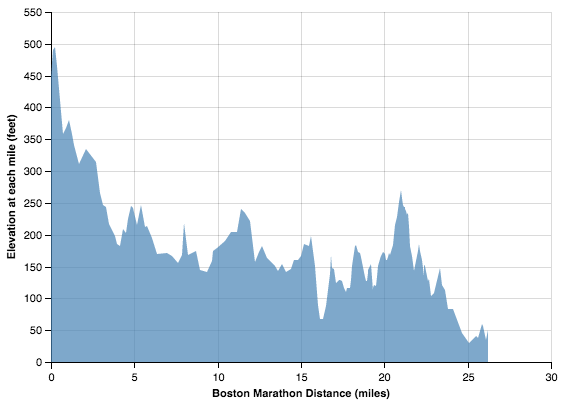

In [72]:
c = Chart(boston_elev).mark_area().encode(
    X('dist_from_start_mile:Q', scale=Scale(domain=(0.0, 30.0)),
      axis=Axis(title='Boston Marathon Distance (miles)')),
    Y('elev_feet:Q',scale=Scale(domain=(28.0, 510)),
      axis=Axis(title='Elevation at each mile (feet)'))
)
c

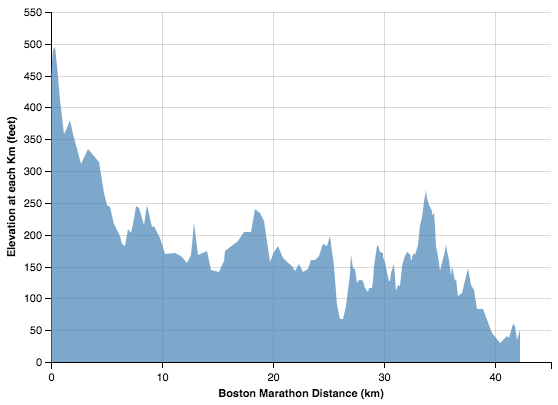

In [73]:
c = Chart(boston_elev).mark_area().encode(
    X('dist_from_start_km:Q', scale=Scale(domain=(0.0, 45.0)),
      axis=Axis(title='Boston Marathon Distance (km)')),
    Y('elev_feet:Q',scale=Scale(domain=(28.0, 510)),
      axis=Axis(title='Elevation at each Km (feet)'))
)
c

### Conclusion
- The race goes from a high altitude to smaller altituted. Sharpe deep at around KM 26.
- Need to look at the performance of runners

## When do runners hit the wall?
---

In [74]:
print boston_2016.shape
boston_2016_wall = boston_2016.copy()
print boston_2016_wall.shape

(26630, 56)
(26630, 56)


In [75]:
'''Wall, a point in the race where runners decide to slow down'''
boston_2016_wall['10k_dif'] = boston_2016_wall['10_k'] - boston_2016_wall['5_k'] 
boston_2016_wall['15k_dif'] = boston_2016_wall['15_k'] - boston_2016_wall['10_k']
boston_2016_wall['20k_dif'] = boston_2016_wall['20_k'] - boston_2016_wall['15_k']
boston_2016_wall['25k_dif'] = boston_2016_wall['25_k'] - boston_2016_wall['20_k']
boston_2016_wall['30k_dif'] = boston_2016_wall['30_k'] - boston_2016_wall['25_k']
boston_2016_wall['35k_dif'] = boston_2016_wall['35_k'] - boston_2016_wall['30_k']
boston_2016_wall['40k_dif'] = boston_2016_wall['40_k'] - boston_2016_wall['35_k']

In [76]:
'''Top 15 male and female runners and the wall'''
top_male_wall = boston_2016_wall[(boston_2016_wall['gender'] == "M")].sort_values(by='official_time', ascending=True).head(15)
top_fem_wall= boston_2016_wall[(boston_2016_wall['gender'] == "F")].sort_values(by='official_time', ascending=True).head(15)
print top_male_wall.shape
print top_male_wall.shape

(15, 63)
(15, 63)


In [77]:
result = top_male_wall.append(top_fem_wall)
result.shape

(30, 63)

In [78]:
test_male_1 = result[['name_16', 'age', 'elev_5k_meter', 'elev_10k_meter', 'elev_15k_meter','elev_20k_meter',
                              'elev_half_meter', 'elev_25k_meter', 'elev_30k_meter', 'elev_35k_meter', 
                              'elev_40k_meter','elev_END_meter']]

test_male_1.rename(columns={'elev_5k_meter': '5k_meter', 'elev_10k_meter': '10k_meter', 
                            'elev_15k_meter': '15k_meter', 'elev_20k_meter': '20k_meter',
                            'elev_25k_meter' : '25k_meter', 'elev_30k_meter': '30k_meter',
                            'elev_35k_meter' : '35k_meter', 'elev_40k_meter': '40k_meter',
                            'elev_half_meter' : 'half', 'elev_END_meter': 'official_time'}, inplace=True)


print test_male_1.shape
test_male_2 = result[['name_16', 'age','5_k', '10_k', '15_k', '20_k', 'half', '25_k', '30_k', '35_k','40_k', 
                                'official_time']]
print test_male_2.shape

(30, 12)
(30, 12)


//anaconda/lib/python2.7/site-packages/pandas/core/frame.py:2834: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  **kwargs)


In [79]:
male_sub_long_1 = pd.melt(test_male_1, id_vars= ['name_16', 'age'])
print male_sub_long_1.shape
male_sub_long_1.head(3)

(300, 4)


,name_16,age,variable,value
0,"Hayle, Lemi Berhanu",21,5k_meter,71.9
1,"Desisa, Lelisa",26,5k_meter,71.9
2,"Tsegay, Yemane Adhane",31,5k_meter,71.9


In [80]:
test_1 = male_sub_long_1.groupby(['variable', 'name_16','age'])[['value']].mean().reset_index()
print test_1.shape
test_1.head(10)

(300, 4)


,variable,name_16,age,value
0,10k_meter,"Baysa, Atsede",29,51.62
1,10k_meter,"Bekele, Tadelech",25,51.62
2,10k_meter,"Beriso, Amane",24,51.62
3,10k_meter,"Burrell, Ian",31,51.62
4,10k_meter,"Chebogut, Stephen",31,51.62
5,10k_meter,"Chepkirui, Joyce",27,51.62
6,10k_meter,"Crouch, Sarah",26,51.62
7,10k_meter,"Daniel, Flomena Cheyech",33,51.62
8,10k_meter,"Daska, Mamitu",32,51.62
9,10k_meter,"Deba, Buzunesh",28,51.62


In [81]:
male_sub_long_2 = pd.melt(test_male_2, id_vars= ['name_16', 'age'])
print male_sub_long_2.shape
male_sub_long_2.head(3)

(300, 4)


,name_16,age,variable,value
0,"Hayle, Lemi Berhanu",21,5_k,15.783333
1,"Desisa, Lelisa",26,5_k,15.783333
2,"Tsegay, Yemane Adhane",31,5_k,15.766667


In [82]:
test_2 = male_sub_long_2.groupby(['variable', 'name_16','age'])[['value']].mean().reset_index()
print test_2.shape
test_2.rename(columns={'value': 'value_time', 'name_16': 'runner_name'}, inplace=True)
test_2.head(3)

(300, 4)


,variable,runner_name,age,value_time
0,10_k,"Baysa, Atsede",29,36.35
1,10_k,"Bekele, Tadelech",25,36.35
2,10_k,"Beriso, Amane",24,36.35


In [83]:
'''creating the data'''
test_a = pd.concat([test_1, test_2], axis=1)
test_a.head(10)

,variable,name_16,age,value,variable,runner_name,age,value_time
0,10k_meter,"Baysa, Atsede",29,51.62,10_k,"Baysa, Atsede",29,36.350000
1,10k_meter,"Bekele, Tadelech",25,51.62,10_k,"Bekele, Tadelech",25,36.350000
2,10k_meter,"Beriso, Amane",24,51.62,10_k,"Beriso, Amane",24,36.350000
3,10k_meter,"Burrell, Ian",31,51.62,10_k,"Burrell, Ian",31,31.783333
4,10k_meter,"Chebogut, Stephen",31,51.62,10_k,"Chebogut, Stephen",31,31.350000
5,10k_meter,"Chepkirui, Joyce",27,51.62,10_k,"Chepkirui, Joyce",27,36.350000
6,10k_meter,"Crouch, Sarah",26,51.62,10_k,"Crouch, Sarah",26,36.350000
7,10k_meter,"Daniel, Flomena Cheyech",33,51.62,10_k,"Daniel, Flomena Cheyech",33,36.350000
8,10k_meter,"Daska, Mamitu",32,51.62,10_k,"Daska, Mamitu",32,36.333333
9,10k_meter,"Deba, Buzunesh",28,51.62,10_k,"Deba, Buzunesh",28,36.333333


In [84]:
print test_a.dtypes
test_a.value = test_a.value.astype(float)
test_a.value_time = test_a.value_time.astype(float)

variable        object
name_16         object
age              int64
value          float64
variable        object
runner_name     object
age              int64
value_time     float64
dtype: object


In [85]:
'''Wall'''
test_male_1_a = result[['name_16', 'age', 'elev_10k_meter', 'elev_15k_meter','elev_20k_meter',
                            'elev_25k_meter', 'elev_30k_meter', 'elev_35k_meter', 
                              'elev_40k_meter']]

test_male_1_a.rename(columns={'elev_10k_meter': '10k_meter', 
                            'elev_15k_meter': '15k_meter', 'elev_20k_meter': '20k_meter',
                            'elev_25k_meter' : '25k_meter', 'elev_30k_meter': '30k_meter',
                            'elev_35k_meter' : '35k_meter', 'elev_40k_meter': '40k_meter',
                            }, inplace=True)
print test_male_1_a.shape
test_male_3 = result[['name_16', 'age', '10k_dif', '15k_dif', '20k_dif', '25k_dif', '30k_dif', '35k_dif', 
                             '40k_dif']]
print test_male_3.shape

(30, 9)
(30, 9)


In [86]:
male_sub_long_1_a = pd.melt(test_male_1_a, id_vars= ['name_16', 'age'])
print male_sub_long_1_a.shape
male_sub_long_1_a.head(3)
print male_sub_long_1_a.dtypes
print "=="

test_1_a = male_sub_long_1_a.groupby(['variable', 'name_16','age'])[['value']].mean().reset_index()
print test_1_a.shape
test_1_a.head(15)
print "=="
male_sub_long_3 = pd.melt(test_male_3, id_vars= ['name_16', 'age'])
print male_sub_long_3.shape
male_sub_long_3.head(3)
print "=="
male_sub_long_3.dtypes

test_3 = male_sub_long_3.groupby(['variable', 'name_16','age'])[['value']].mean().reset_index()
print test_3.shape
test_3.rename(columns={'value': 'value_time', 'name_16': 'runner_name'}, inplace=True)
test_3.head(3)

(210, 4)
name_16      object
age           int64
variable     object
value       float64
dtype: object
==
(210, 4)
==
(210, 4)
==
(210, 4)


,variable,runner_name,age,value_time
0,10k_dif,"Baysa, Atsede",29,17.983333
1,10k_dif,"Bekele, Tadelech",25,17.966667
2,10k_dif,"Beriso, Amane",24,17.966667


In [87]:
'''creating the data'''
test_b = pd.concat([test_1_a, test_3], axis=1)
test_b.head(10)

,variable,name_16,age,value,variable,runner_name,age,value_time
0,10k_meter,"Baysa, Atsede",29,51.62,10k_dif,"Baysa, Atsede",29,17.983333
1,10k_meter,"Bekele, Tadelech",25,51.62,10k_dif,"Bekele, Tadelech",25,17.966667
2,10k_meter,"Beriso, Amane",24,51.62,10k_dif,"Beriso, Amane",24,17.966667
3,10k_meter,"Burrell, Ian",31,51.62,10k_dif,"Burrell, Ian",31,15.883333
4,10k_meter,"Chebogut, Stephen",31,51.62,10k_dif,"Chebogut, Stephen",31,15.566667
5,10k_meter,"Chepkirui, Joyce",27,51.62,10k_dif,"Chepkirui, Joyce",27,17.983333
6,10k_meter,"Crouch, Sarah",26,51.62,10k_dif,"Crouch, Sarah",26,17.983333
7,10k_meter,"Daniel, Flomena Cheyech",33,51.62,10k_dif,"Daniel, Flomena Cheyech",33,17.983333
8,10k_meter,"Daska, Mamitu",32,51.62,10k_dif,"Daska, Mamitu",32,17.966667
9,10k_meter,"Deba, Buzunesh",28,51.62,10k_dif,"Deba, Buzunesh",28,17.966667


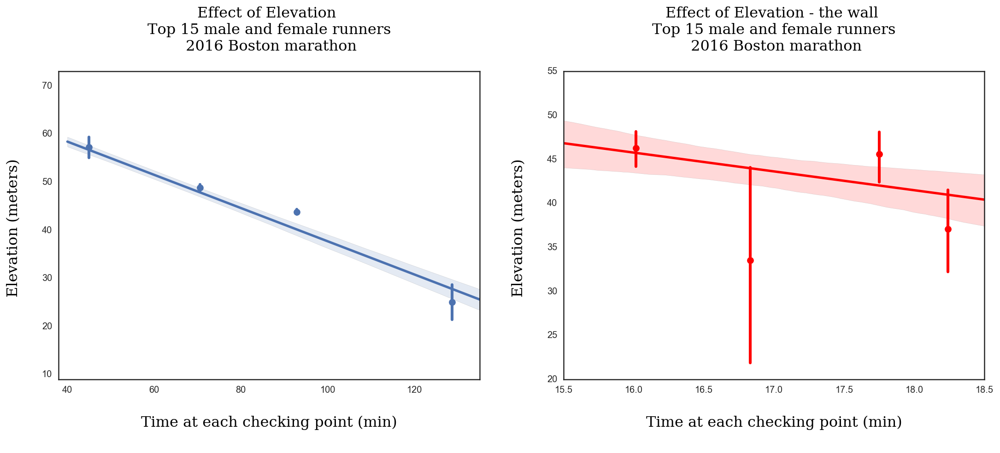

In [88]:
fig = plt.figure(figsize=(18,6))


ax1 = plt.subplot(1,2,1)
sns.regplot(test_a.value_time, test_a.value, ci=95, x_jitter=.9, x_bins=4, marker="o")
plt.title('Effect of Elevation \n Top 15 male and female runners \n 2016 Boston marathon\n', fontdict=font)
plt.ylabel('Elevation (meters) \n', fontdict=font)
plt.xlabel('\n Time at each checking point (min) \n', fontdict=font)
plt.legend(loc='best')
plt.xlim([38.0, 135.0])
plt.ylim([9.0, 73.0])

ax2 = plt.subplot(1,2,2)
sns.regplot(test_b.value_time, test_b.value, ci=95, x_jitter=.9, x_bins=4, color ='r')
plt.title('Effect of Elevation - the wall \n Top 15 male and female runners \n 2016 Boston marathon\n', fontdict=font)
plt.ylabel('Elevation (meters) \n', fontdict=font)
plt.xlabel('\n Time at each checking point (min) \n', fontdict=font)
plt.legend(loc='best')

plt.show()



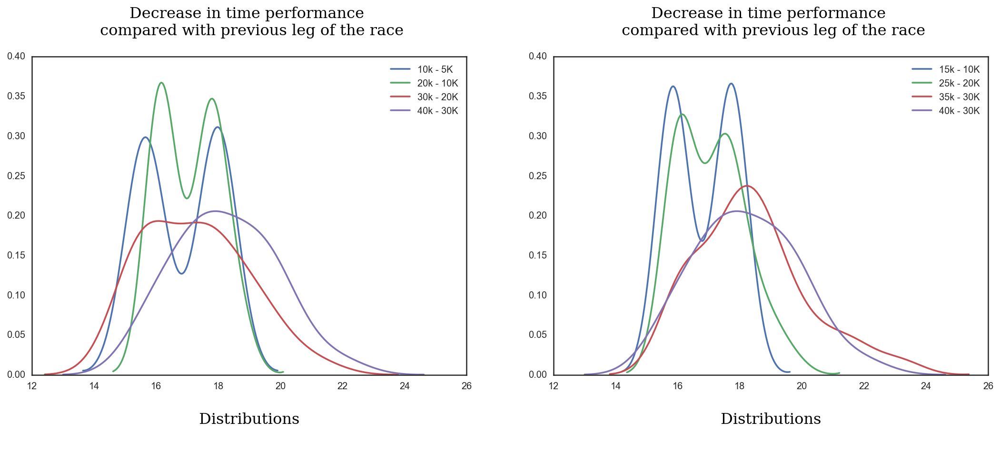

In [89]:
fig = plt.figure(figsize=(18,6))


ax1 = plt.subplot(1,2,1)
sns.distplot(result['10k_dif'],  hist=False, label='10k - 5K')
sns.distplot(result['20k_dif'], hist=False, label='20k - 10K')
sns.distplot(result['30k_dif'],  hist=False, label='30k - 20K')
sns.distplot(result['40k_dif'],  hist=False, label='40k - 30K')
# plt.xlim([-5,10])
plt.legend(loc='best')
plt.title('Decrease in time performance \n compared with previous leg of the race\n' , fontdict=font)
plt.xlabel('\n Distributions \n', fontdict=font)

ax2 = plt.subplot(1,2,2)
sns.distplot(result['15k_dif'],  hist=False, label='15k - 10K')
sns.distplot(result['25k_dif'], hist=False, label='25k - 20K')
sns.distplot(result['35k_dif'],  hist=False, label='35k - 30K')
sns.distplot(result['40k_dif'],  hist=False, label='40k - 30K')
# plt.xlim([-5,10])
plt.legend(loc='best')
plt.title('Decrease in time performance \n compared with previous leg of the race\n' , fontdict=font)
plt.xlabel('\n Distributions \n', fontdict=font)

#fig.savefig('../graphs/rank_gender_time.pdf')
plt.show()

## Pace and Finishing times?
---

In [90]:
'''Top 5 runners and the wall'''
top_15_male_wall = boston_2016_wall[(boston_2016_wall['gender'] == "M")].sort_values(by='official_time', ascending=True).head(15)
top_15_fem_wall= boston_2016_wall[(boston_2016_wall['gender'] == "F")].sort_values(by='official_time', ascending=True).head(15)
print top_15_male_wall.shape
print top_15_fem_wall.shape

(15, 63)
(15, 63)


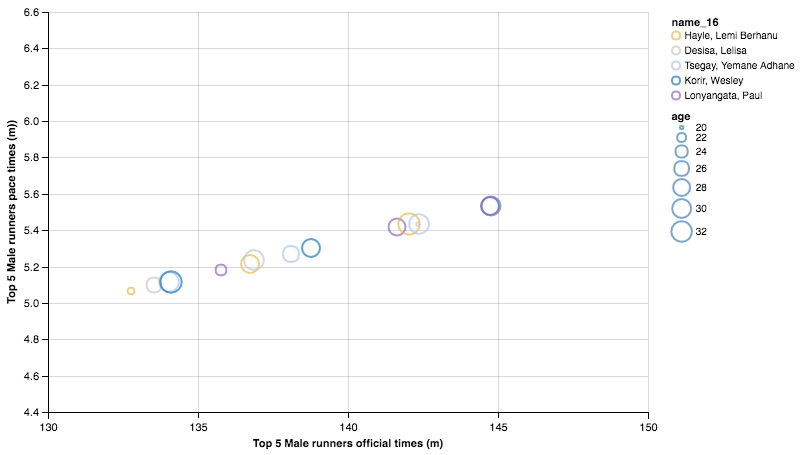

In [132]:
from altair import Scale

scale = Scale(domain=['Hayle, Lemi Berhanu', 'Desisa, Lelisa', 'Tsegay, Yemane Adhane', 
                      'Korir, Wesley', 'Lonyangata, Paul'],
              range=['#e7ba52', '#c7c7c7', '#aec7e8', '#1f77b4', '#9467bd'])

Chart(top_15_male_wall).mark_point().encode(
    X('official_time', scale=Scale(domain=(130, 150.0)),
      axis=Axis(title='Top 5 Male runners official times (m)')),
    Y('pace', scale=Scale(domain=(4.5, 6.5)),
      axis=Axis(title='Top 5 Male runners pace times (m))')),
    Color('name_16', scale=scale),
    size='age',
).configure_cell(width=600, height=400)

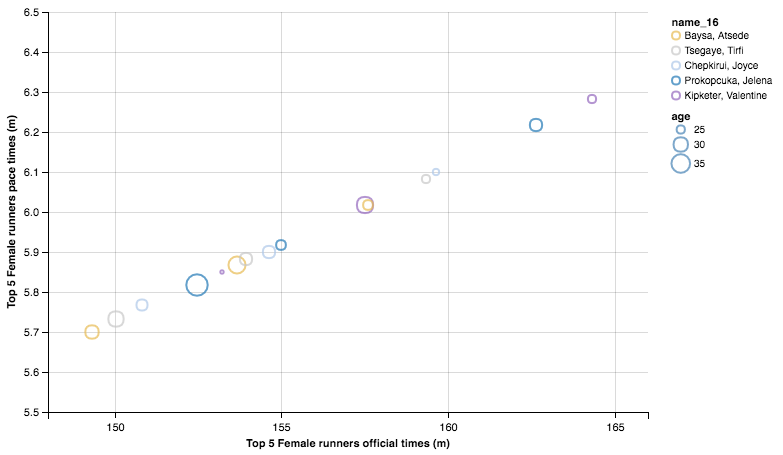

In [133]:
scale = Scale(domain=['Baysa, Atsede', 'Tsegaye, Tirfi', 'Chepkirui, Joyce', 
                      'Prokopcuka, Jelena', 'Kipketer, Valentine'],
              range=['#e7ba52', '#c7c7c7', '#aec7e8', '#1f77b4', '#9467bd'])

Chart(top_15_fem_wall).mark_point().encode(
    X('official_time', scale=Scale(domain=(148.0, 166.0)),
      axis=Axis(title='Top 5 Female runners official times (m)')),
    Y('pace', scale=Scale(domain=(5.5, 6.5)),
      axis=Axis(title='Top 5 Female runners pace times (m)')),
    Color('name_16', scale=scale),
    size='age',
).configure_cell(width=600, height=400)

In [93]:
# '''Number of runners by gender and country of residence'''
# fig = plt.figure(figsize=(15,8))
# ax = fig.gca()
# sns.set_style("whitegrid")
# boston_2016.groupby(['country_res', 'gender']).size().sort_values(ascending=False).head(20).plot(
#     kind="barh", colors=['limegreen', 'oldlace'], ax=ax)
# plt.title('Top 20 most popular country of residence and gender \n 2016 Boston marathon participants\n', fontsize = 20)
# plt.ylabel('Country of Residence\n Gender\n', fontsize=20)
# plt.xlabel('Number of runners\n', fontsize=20)
# plt.show()

In [94]:

# c = Chart(boston_2016).mark_bar().encode(
#     y=Y('country_res', sort=SortField(field='age', order='descending', op='average'),
#         axis=Axis(title='Country of Residence')),
#     x=X('average(age)',
#         axis=Axis(title='Average of runner')),
#         color=Color('gender:N', scale=Scale(range=cb.qualitative.Dark2_8.hex_colors)))

# c

In [95]:
# c = Chart(boston_2016[ (boston_2016['country_res']=='USA') & (boston_2016['state']!="NaN")]).mark_bar().encode(
#     y=Y('state', sort=SortField(field='age', order='descending', op='average'),
#         axis=Axis(title='Country of Residence')),
#     x=X('average(age)',
#         axis=Axis(title='Average of runner')),
#         color=Color('gender:N', scale=Scale(range=cb.qualitative.Dark2_8.hex_colors)))

# c

### Saving clean datasets
---

In [96]:
import cPickle
f = open('../clean_data/boston_2016.save', 'wb')
cPickle.dump(boston_2016,   f)
f.close()


# 2015 Boston Marathon - Analysis 

In [97]:
boston_2015 = pd.read_csv('../raw_data/Runners_all_results_2015.csv')

In [98]:
boston_2015.head(3).T

,0,1,2
BibNumber,3,4,8
FullName,Lelisa Desisa,Yemane Adhane Tsegay,Wilson Chebet
SortName,"Desisa, Lelisa","Tsegay, Yemane Adhane","Chebet, Wilson"
AgeOnRaceDay,25,30,29
Gender,M,M,M
City,Ambo,Addis Ababa,Marakwet
StateAbbrev,NaN,NaN,NaN
StateName,NaN,NaN,NaN
Zip,NaN,NaN,NaN
CountryOfResAbbrev,ETH,ETH,KEN


In [99]:
old_names = boston_2015.columns.tolist()
new_names = ['bib_number', 'full_name', 'name_15', 'age_15', 'gender', 'city',
             'state','state_name','zip','country_res','country_res_name', 
             'country_ctz_abbrev','country_ctz_name','official_time_15','rank_overall_15',
             'rank_over_gender_15', 'rank_over_division_15','event_group','sub_group_label','sub_group']
boston_2015.rename(columns=dict(zip(old_names, new_names)), inplace=True)

In [100]:
'''Separating Last Name from First and Middle names and then dropping Name col'''
boston_2015['last_name'], boston_2015['first_names'] = boston_2015['name_15'].str.split(',', 1).str
# boston_2016.drop('Name', axis=1, inplace=True)


In [101]:
'''Changing time to minutes'''
boston_2015['official_time_15'] = minute_time(boston_2015['official_time_15'])

In [102]:
print boston_2015.shape
print ''
boston_2015.head(3).T

(26598, 22)



,0,1,2
bib_number,3,4,8
full_name,Lelisa Desisa,Yemane Adhane Tsegay,Wilson Chebet
name_15,"Desisa, Lelisa","Tsegay, Yemane Adhane","Chebet, Wilson"
age_15,25,30,29
gender,M,M,M
city,Ambo,Addis Ababa,Marakwet
state,NaN,NaN,NaN
state_name,NaN,NaN,NaN
zip,NaN,NaN,NaN
country_res,ETH,ETH,KEN


In [103]:
boston_2015.describe().T

,count,mean,std,min,25%,50%,75%,max
age_15,26598.0,42.143996,11.294322,18.000000,33.000000,42.000000,50.0000,82.000000
official_time_15,26598.0,226.419390,40.455538,129.283333,198.633333,219.658333,246.4125,486.016667
rank_overall_15,26598.0,13299.500000,7678.325566,1.000000,6650.250000,13299.500000,19948.7500,26598.000000
rank_over_gender_15,26598.0,6711.694902,3944.093781,1.000000,3325.250000,6650.000000,9974.7500,14580.000000
rank_over_division_15,26598.0,1654.209865,1477.353030,1.000000,518.000000,1205.000000,2268.7500,6005.000000


In [104]:
boston_2015.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 26598 entries, 0 to 26597
Data columns (total 22 columns):
bib_number               26598 non-null object
full_name                26598 non-null object
name_15                  26598 non-null object
age_15                   26598 non-null int64
gender                   26598 non-null object
city                     26598 non-null object
state                    24048 non-null object
state_name               24048 non-null object
zip                      26434 non-null object
country_res              26598 non-null object
country_res_name         26598 non-null object
country_ctz_abbrev       26598 non-null object
country_ctz_name         26598 non-null object
official_time_15         26598 non-null float64
rank_overall_15          26598 non-null int64
rank_over_gender_15      26598 non-null int64
rank_over_division_15    26598 non-null int64
event_group              26598 non-null object
sub_group_label          67 non-null object
sub_

In [105]:
'''checking for duplicates'''
col_15 = boston_2015.columns.tolist()
duplic_checker(boston_2015, col_15)

There are duplicates in full_name
--------------------

There are duplicates in name_15
--------------------

There are duplicates in age_15
--------------------

There are duplicates in gender
--------------------

There are duplicates in city
--------------------

There are duplicates in state
--------------------

There are duplicates in state_name
--------------------

There are duplicates in zip
--------------------

There are duplicates in country_res
--------------------

There are duplicates in country_res_name
--------------------

There are duplicates in country_ctz_abbrev
--------------------

There are duplicates in country_ctz_name
--------------------

There are duplicates in official_time_15
--------------------

There are duplicates in rank_over_gender_15
--------------------

There are duplicates in rank_over_division_15
--------------------

There are duplicates in event_group
--------------------

There are duplicates in sub_group_label
--------------------

There ar

In [106]:
'''missing values'''
missing_checker(boston_2015, col_15)

Nimber of missing values in state is: 2550
--------------------

Nimber of missing values in state_name is: 2550
--------------------

Nimber of missing values in zip is: 164
--------------------

Nimber of missing values in sub_group_label is: 26531
--------------------

Nimber of missing values in sub_group is: 26531
--------------------



In [107]:
des= '''No duplicates based on bib number, we can assume that the total number of runners is: '''
print des, boston_2015.shape[0]
print ''
des_1 = '''Total number of male runners in the 2015 boston marathon is: '''
print des_1, boston_2015.gender.value_counts().values[0]
print ''
des_1 = '''Total number of female runners in the 2015 boston marathon is: '''
print des_1, boston_2015.gender.value_counts().values[1]

No duplicates based on bib number, we can assume that the total number of runners is:  26598

Total number of male runners in the 2015 boston marathon is:  14580

Total number of female runners in the 2015 boston marathon is:  12018


## Analysis of Age
---

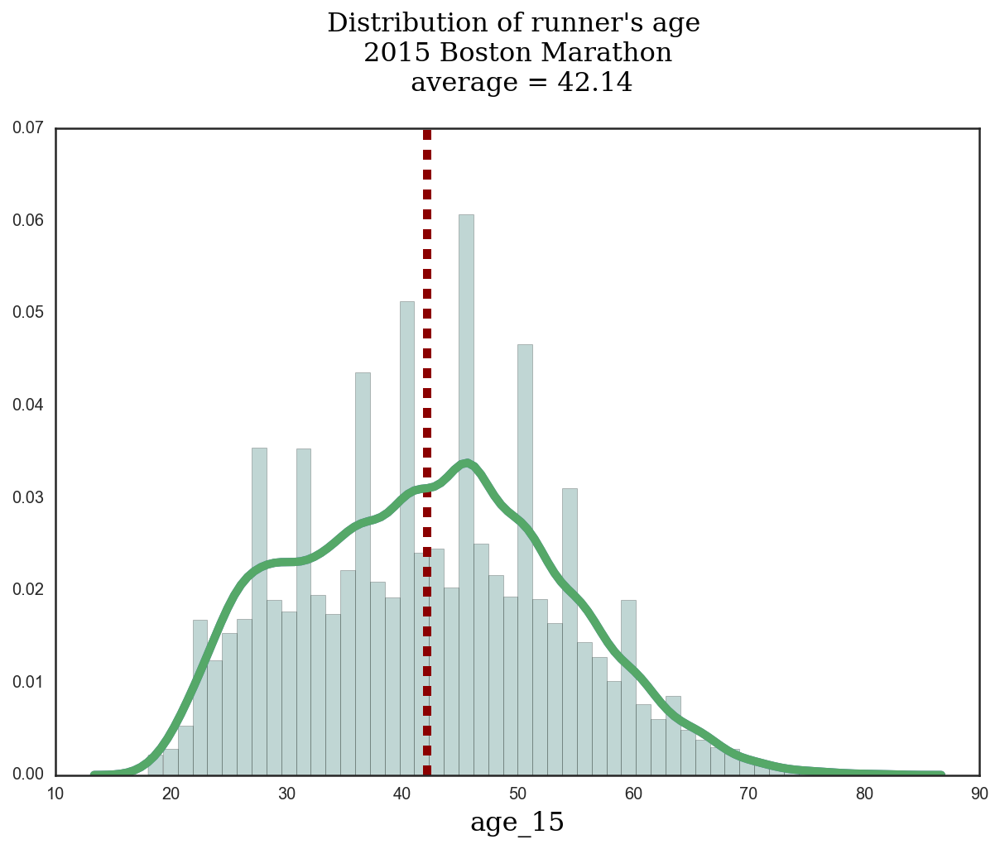

In [108]:
histogram_plotter("runner's age \n2015 Boston Marathon\n", boston_2015.age_15)

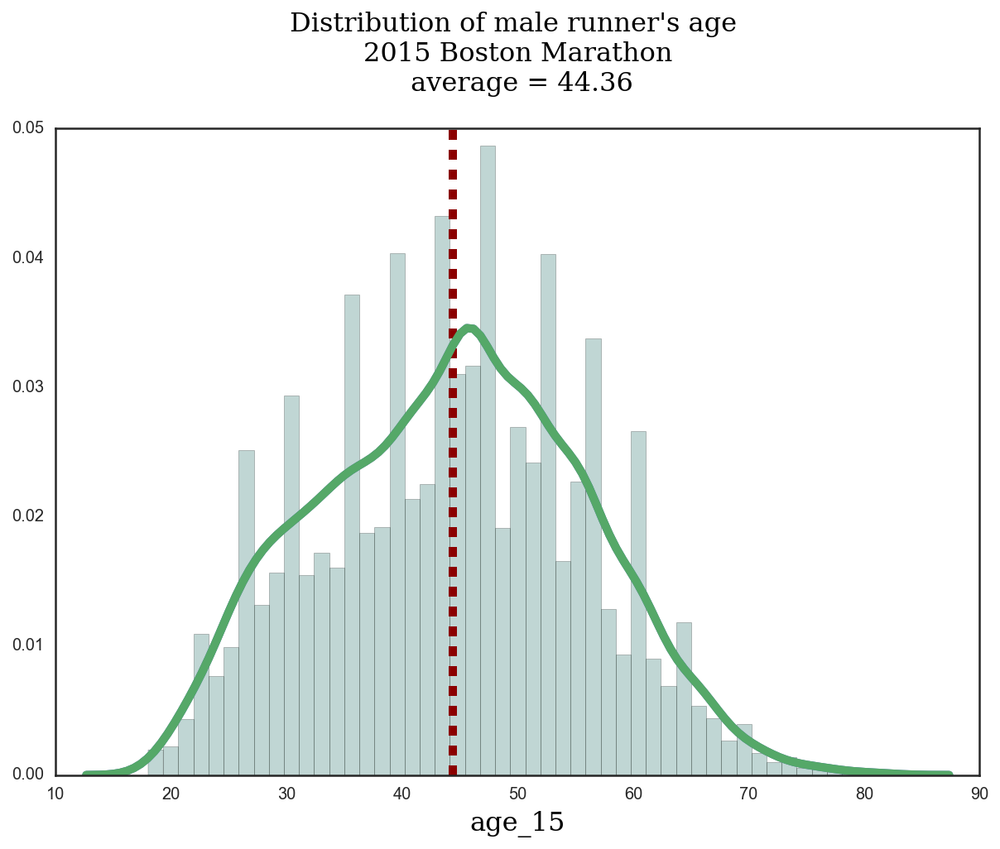

In [109]:
histogram_plotter("male runner's age \n2015 Boston Marathon\n", boston_2015[boston_2015.gender=='M'].age_15)

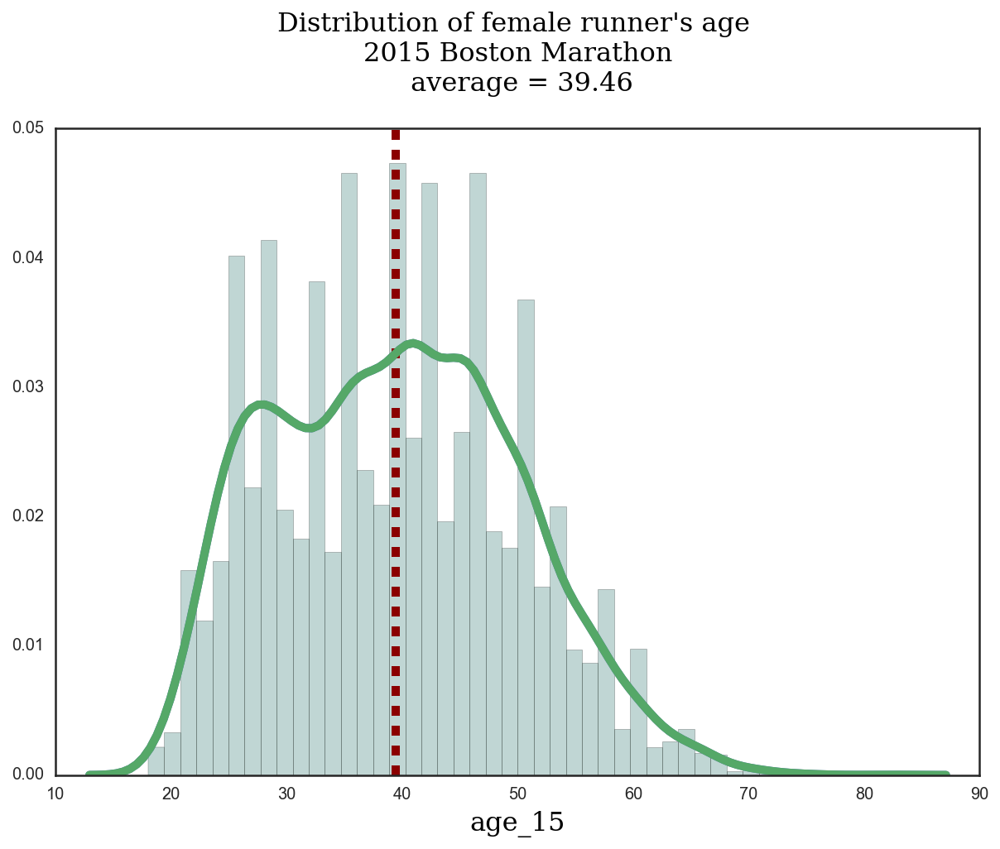

In [110]:
histogram_plotter("female runner's age \n2015 Boston Marathon\n", boston_2015[boston_2015.gender=='F'].age_15)

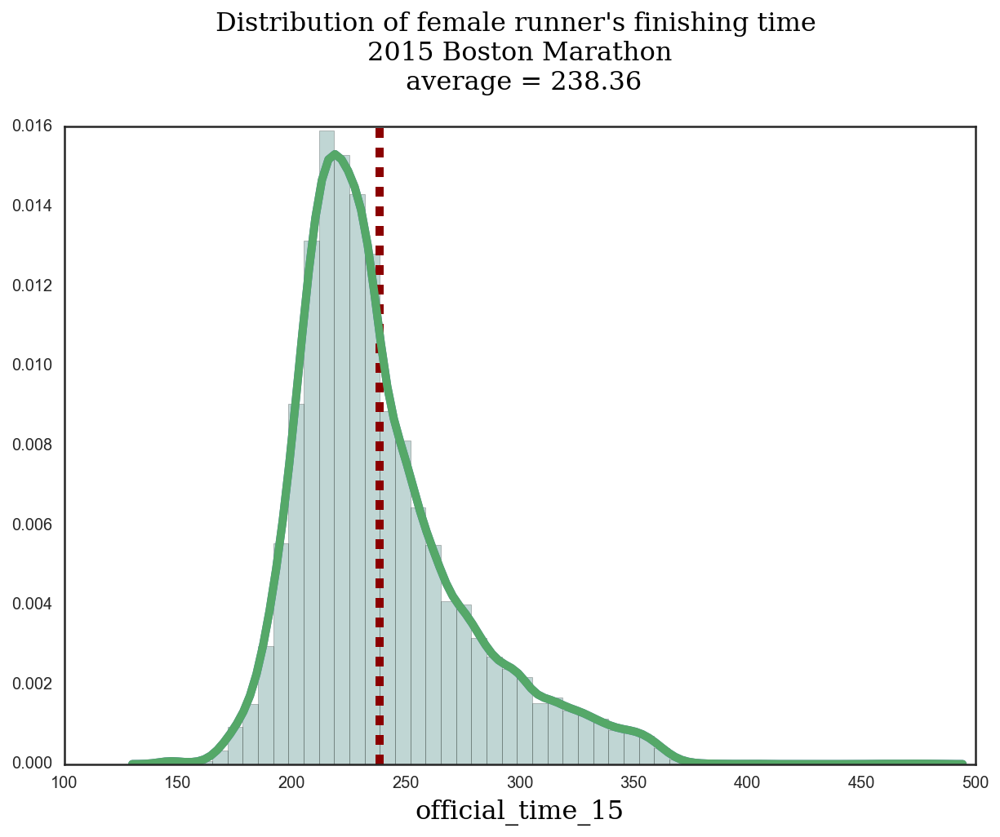

In [130]:
histogram_plotter("female runner's finishing time \n2015 Boston Marathon\n", boston_2015[boston_2015.gender=='F'].official_time_15)

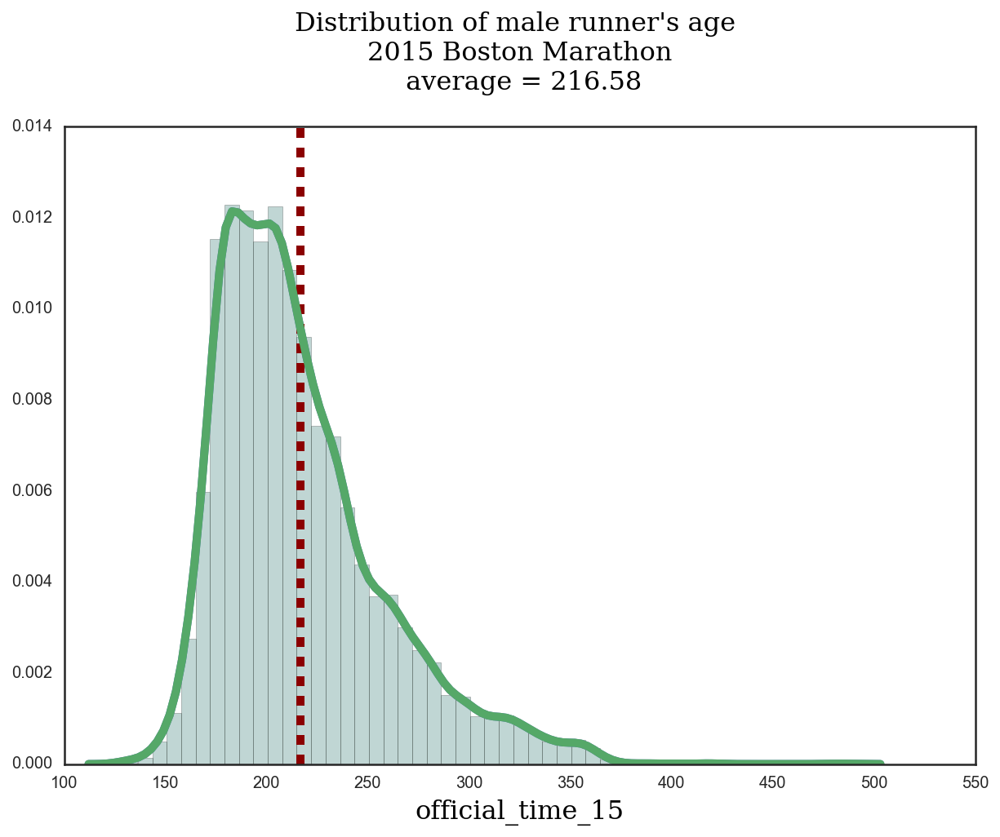

In [131]:
histogram_plotter("male runner's age \n2015 Boston Marathon\n", boston_2015[boston_2015.gender=='M'].official_time_15)

########################
### Saving 2015 data
---

In [111]:
import cPickle
f = open('../clean_data/boston_2015.save', 'wb')
cPickle.dump(boston_2015,   f)
f.close()

### Merging datasets
---

In [112]:
short_bost_15 =  boston_2015[[col for col in boston_2015.columns.tolist() 
                              if col in ['name_15', 'last_name', 'first_names', 'age_15', 
                                         'country_res','official_time_15', 'gender']]]
print short_bost_15.shape
short_bost_15.head(3)

(26598, 7)


,name_15,age_15,gender,country_res,official_time_15,last_name,first_names
0,"Desisa, Lelisa",25,M,ETH,129.283333,Desisa,Lelisa
1,"Tsegay, Yemane Adhane",30,M,ETH,129.800000,Tsegay,Yemane Adhane
2,"Chebet, Wilson",29,M,KEN,130.366667,Chebet,Wilson


In [113]:
not_need_list =  ['city', 'rank_overall', 'rank_over_gender', 'rank_over_division', 'bib_number',  'state',  'country_ctz',]
## consider looking at rank_overall
## consider keeping state

short_bost_16 = boston_2016[[col for col in boston_2016.columns.tolist() 
                            if col not in not_need_list ]]

short_bost_16.rename(columns={ 'official_time' : 'official_time_16', 'age': 'age_16', 'gender' : 'gender_16',
                               'proj_time' : 'proj_time_16', 'split_ratio' : 'split_ratio_16', 'pace' :'pace_16'
                             }, inplace=True )
print short_bost_16.shape
short_bost_16.head(3).T

(26630, 49)


,0,1,2
name_16,"Hayle, Lemi Berhanu","Desisa, Lelisa","Tsegay, Yemane Adhane"
age_16,21,26,31
gender_16,M,M,M
country_res,ETH,ETH,ETH
5_k,15.7833,15.7833,15.7667
10_k,31.3333,31.35,31.3333
15_k,47.1167,47.1333,47.1167
20_k,63.2333,63.2333,63.2167
half,66.75,66.7667,66.7333
25_k,79.25,79.25,79.25


In [114]:
'''merging datasets'''
boston_16_15 = pd.merge(short_bost_16, short_bost_15, on=['last_name', 'first_names', "country_res"], how='inner')
print boston_16_15.shape
boston_16_15.head(3).T

(5553, 53)


,0,1,2
name_16,"Desisa, Lelisa","Tsegay, Yemane Adhane","Korir, Wesley"
age_16,26,31,33
gender_16,M,M,M
country_res,ETH,ETH,KEN
5_k,15.7833,15.7667,15.7667
10_k,31.35,31.3333,31.35
15_k,47.1333,47.1167,47.1167
20_k,63.2333,63.2167,63.2333
half,66.7667,66.7333,66.7667
25_k,79.25,79.25,79.2667


In [115]:
'''If runner competed in 2015, the difference in age between 2016 and 2015 needs to be = 1'''
boston_16_15['age_dif'] = (boston_16_15['age_16'] - boston_16_15['age_15'])
boston_16_15 = boston_16_15[boston_16_15['age_dif']==1]
boston_16_15['age_dif'].value_counts()

1    5438
Name: age_dif, dtype: int64

In [116]:
'''no missing values'''
boston_16_15.isnull().sum()

name_16               0
age_16                0
gender_16             0
country_res           0
5_k                   0
10_k                  0
15_k                  0
20_k                  0
half                  0
25_k                  0
30_k                  0
35_k                  0
40_k                  0
pace_16               0
proj_time_16          0
official_time_16      0
last_name             0
first_names           0
split_ratio_16        0
elev_5k_meter         0
elev_10k_meter        0
elev_15k_meter        0
elev_20k_meter        0
elev_half_meter       0
elev_25k_meter        0
elev_30k_meter        0
elev_35k_meter        0
elev_40k_meter        0
elev_END_meter        0
cumm_asc_5k_met       0
cumm_asc_10k_met      0
cumm_asc_15k_met      0
cumm_asc_20k_met      0
cumm_asc_half_met     0
cumm_asc_25k_met      0
cumm_asc_30k_met      0
cumm_asc_35k_met      0
cumm_asc_40k_met      0
cumm_asc_END_met      0
desc_cumm_5k_met      0
desc_cumm_10k_met     0
desc_cumm_15k_me

In [117]:
'''Same gender?'''
print boston_16_15['gender_16'].value_counts()
print boston_16_15['gender'].value_counts()
(boston_16_15['gender_16'] == boston_16_15['gender']).isnull().sum()

M    3212
F    2226
Name: gender_16, dtype: int64
M    3212
F    2226
Name: gender, dtype: int64


0

### Conclusion
- It looks like only 5438 runners competed in 2015 and 2016, we check their gender age difference

## Is there any relationship between finishing times in 2015 and finishing times in 2016?
---

In [118]:
'''we are good now lets drop col that do not need anymore'''
boston_16_15.drop(['gender_16', 'name_16', 'name_15', 'age_dif'], axis=1, inplace=True)

In [119]:
boston_16_15.sort_values(by=['official_time_16', 'official_time_15'], ascending=True).head(10)

,age_16,country_res,5_k,10_k,15_k,20_k,half,25_k,30_k,35_k,...,desc_cumm_20k_met,desc_cumm_half_met,desc_cumm_25k_met,desc_cumm_30k_met,desc_cumm_35k_met,desc_cumm_40k_met,desc_cumm_END_met,age_15,gender,official_time_15
0,26,ETH,15.783333,31.350000,47.133333,63.233333,66.766667,79.250000,94.283333,110.400000,...,-6062.0,-6474.46,-9064.23,-17833.9,-30207.39,-35552.45,-38069.75,25,M,129.283333
1,31,ETH,15.766667,31.333333,47.116667,63.216667,66.733333,79.250000,94.750000,110.800000,...,-6062.0,-6474.46,-9064.23,-17833.9,-30207.39,-35552.45,-38069.75,30,M,129.800000
2,33,KEN,15.766667,31.350000,47.116667,63.233333,66.766667,79.266667,94.750000,110.800000,...,-6062.0,-6474.46,-9064.23,-17833.9,-30207.39,-35552.45,-38069.75,32,M,130.816667
4,24,USA,16.700000,33.300000,50.283333,67.616667,71.433333,85.033333,103.116667,121.633333,...,-6062.0,-6474.46,-9064.23,-17833.9,-30207.39,-35552.45,-38069.75,23,M,149.333333
5,28,USA,17.600000,34.750000,52.100000,69.516667,73.250000,86.800000,104.716667,123.216667,...,-6062.0,-6474.46,-9064.23,-17833.9,-30207.39,-35552.45,-38069.75,27,M,147.133333
6,27,USA,17.200000,34.666667,52.316667,70.016667,73.816667,87.650000,105.450000,123.850000,...,-6062.0,-6474.46,-9064.23,-17833.9,-30207.39,-35552.45,-38069.75,26,M,153.050000
7,27,KEN,18.366667,36.350000,54.000000,71.750000,75.533333,89.216667,106.550000,124.483333,...,-6062.0,-6474.46,-9064.23,-17833.9,-30207.39,-35552.45,-38069.75,26,F,149.116667
8,24,USA,18.183333,36.100000,54.150000,72.200000,76.083333,90.100000,108.183333,126.266667,...,-6062.0,-6474.46,-9064.23,-17833.9,-30207.39,-35552.45,-38069.75,23,M,153.783333
9,42,USA,16.766667,33.733333,51.150000,68.716667,72.533333,86.316667,104.800000,123.883333,...,-6062.0,-6474.46,-9064.23,-17833.9,-30207.39,-35552.45,-38069.75,41,M,147.333333
10,24,USA,16.483333,33.383333,50.683333,68.166667,71.966667,85.833333,104.883333,124.550000,...,-6062.0,-6474.46,-9064.23,-17833.9,-30207.39,-35552.45,-38069.75,23,M,146.600000


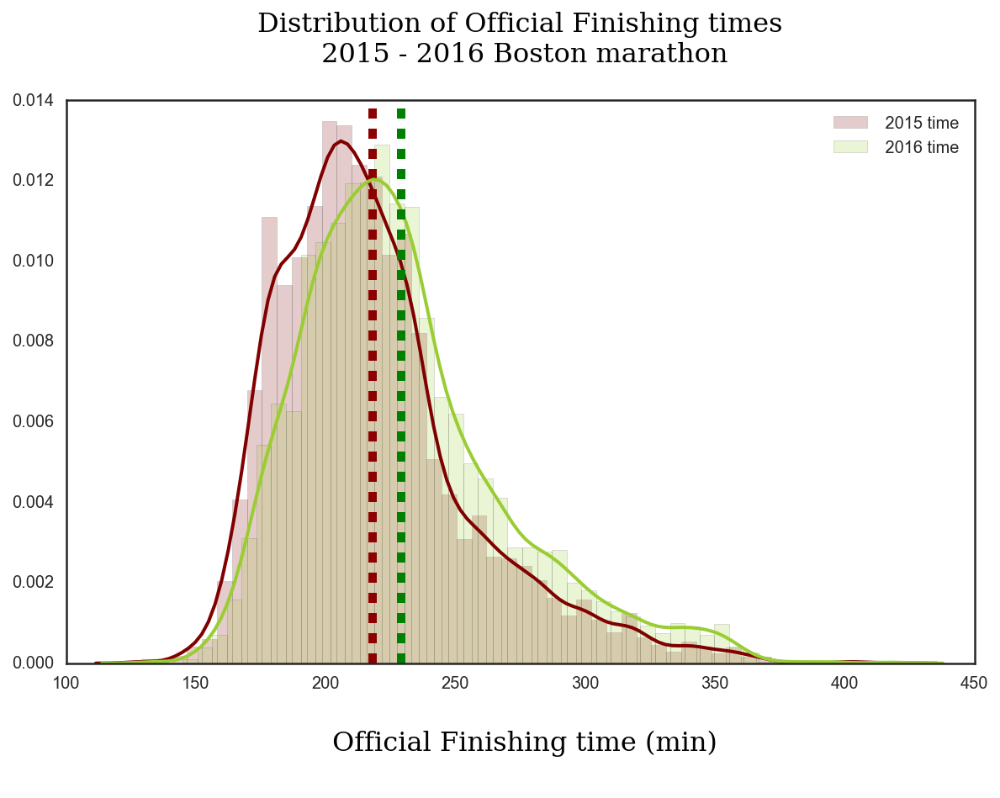

In [120]:
fig = plt.figure(figsize=(10,6))
ax = fig.gca()

'''2015 time'''
dist = sns.distplot(boston_16_15.official_time_15, ax=ax, color='maroon', 
                                 hist_kws={'alpha':0.2}, kde_kws={'linewidth':2}, label=" 2015 time")
dist.axvline(np.mean(boston_16_15.official_time_15), lw=5, c='darkred', ls='dashed')

'''2016 time'''
dist = sns.distplot(boston_16_15.official_time_16, ax=ax, color='yellowgreen', 
                                 hist_kws={'alpha':0.2}, kde_kws={'linewidth':2}, label=" 2016 time")
dist.axvline(np.mean(boston_16_15.official_time_16), lw=5, c='g', ls='dashed')

plt.title('Distribution of Official Finishing times\n 2015 - 2016 Boston marathon\n', fontdict=font)
# plt.ylabel('Time in minutes\n', fontdict=font)
plt.xlabel('\n Official Finishing time (min)\n', fontdict=font)
plt.legend(loc='best')

plt.subplots_adjust(left=0.15)
#fig.savefig('../graphs/rank_gender_time.pdf')
plt.show()



### Conclusion
- From the graph it looks like the average official finishing time in 2015 is less than the average official finishing time in 2016. This implies that the runners who competed in the 2015 and 2016 marathon, "on average" run faster.

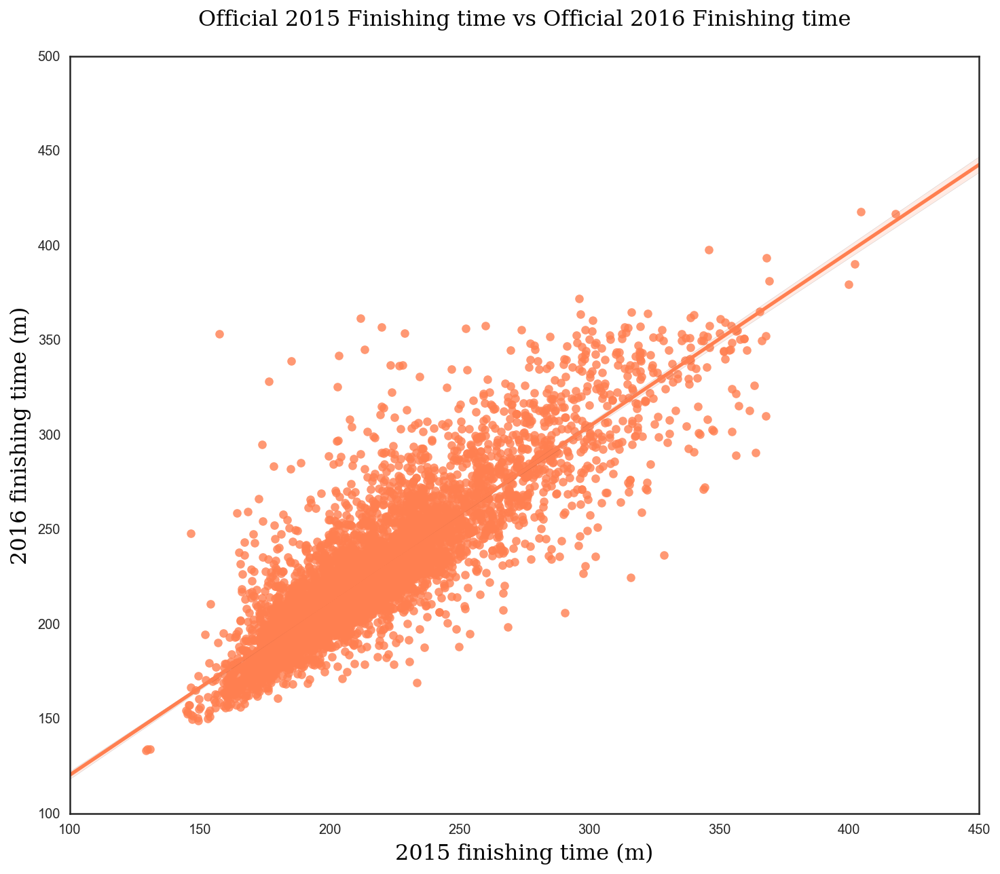

In [121]:
fig = plt.figure(figsize=(12,10))
ax = fig.gca()
sns.regplot(boston_16_15.official_time_15, boston_16_15.official_time_16, 
            ax=ax, scatter_kws={'s':40}, color='coral')
ax.set_xlabel('2015 finishing time (m)', fontdict=font)
ax.set_ylabel('2016 finishing time (m)', fontdict=font)
ax.set_title('Official 2015 Finishing time vs Official 2016 Finishing time\n', fontdict=font)
plt.show()

In [122]:
# Pearson r:
print np.corrcoef(boston_16_15.official_time_15, boston_16_15.official_time_16)

# Spearman rho:
import scipy.stats as stats
print stats.spearmanr(boston_16_15.official_time_15, boston_16_15.official_time_16)

[[ 1.          0.86352888]
 [ 0.86352888  1.        ]]
SpearmanrResult(correlation=0.85699257896138836, pvalue=0.0)


### Conclusion
- The graph suggest that there is a positive relationship between the 2015 and 2016 finishiing times, or that it is possible for the 2015 finishing time to explain the 2016 finishing time

- This is corroborated by the strong positive Spearma correlation coefficient 

########
### Saving merged data
---

In [123]:
import cPickle
f = open('../clean_data/boston_16_15.save', 'wb')
cPickle.dump(boston_16_15,   f)
f.close()